In [1]:
# Data Science Tools
import bioinfokit as bik
from bioinfokit.analys import norm
import numpy as np
import pandas as pd
import seaborn as sns
import scipy.stats as stats
from scipy.io import mmread
import matplotlib.pyplot as plt
import matplotlib as mpl
from scipy.stats import gaussian_kde

In [2]:
# AbSeq_counts = pd.read_csv("AbSeq Molecule Counts.csv", low_memory=False,skiprows = 0)
# AbSeq_counts = AbSeq_counts.T
# AbSeq_counts.to_csv('AbSeq Molecule Counts.csv')
AbSeq_counts = pd.read_csv("AbSeq Molecule Counts.csv", low_memory=False,skiprows = 1)
AbSeq_counts = AbSeq_counts.rename(columns={'Unnamed: 0': 'Cell_Index'})
AbSeq_counts['Cell_Index'] = AbSeq_counts['Cell_Index'].str.replace('.',' ')
AbSeq_counts.set_index(['Cell_Index'], inplace=True)
AbSeq_counts.head()

,CD120A-TNFRSF1A-AHS0439-pAbO,CD120b-TNFRSF1B-AHS0421-pAbO,CD14:MPHIP9-CD14-AHS0037-pAbO,CD16:B73.1-FCGR3A-FCGR3B-AHS0242-pAbO,CD19:HIB19-CD19-AHS0161-pAbO,CD45RA:HI100-PTPRC-AHS0009-pAbO,CD45RO-PTPRC-AHS0036-pAbO,CD4:SK3-CD4-AHS0032-pAbO,CD56:NCAM16.2-NCAM1-AHS0019-pAbO,CD8:SK1-CD8A-AHS0228-pAbO
Cell_Index,,,,,,,,,,
Group_PBMCs_Sample_PBMCs 1_3794,4,44,0,7,9,524,4,13,1,1875
Group_PBMCs_Sample_PBMCs 1_54922,13,380,30,2395,7,574,11,505,3,21
Group_PBMCs_Sample_PBMCs 1_68296,4,208,0,386,10,202,2,20,72,171
Group_PBMCs_Sample_PBMCs 1_97680,3,70,2,573,6,163,5,20,55,11
Group_PBMCs_Sample_PBMCs 1_121103,8,97,8,121,8,91,8,10,89,423


In [3]:
AUC = pd.read_csv("Cellular Response to TNFa AUC.csv", low_memory=False)
AUC = AUC.rename(columns={'Unnamed: 0': 'Cell_Index', 'geneSet' : 'AUC TNFa'})
AUC.set_index(['Cell_Index'], inplace=True)
AUC.head()

,AUC TNFa
Cell_Index,
Group_PBMCs_Sample_PBMCs 1_3794,0.075993
Group_PBMCs_Sample_PBMCs 1_54922,0.209374
Group_PBMCs_Sample_PBMCs 1_68296,0.019589
Group_PBMCs_Sample_PBMCs 1_97680,0.103553
Group_PBMCs_Sample_PBMCs 1_121103,0.067298


In [4]:
PEX = pd.read_csv("Protein Expression.csv", low_memory=False)
PEX = PEX.rename(columns={'Unnamed: 0': 'Cell_Index', 
                          'CD120A-TNFRSF1A-AHS0439-pAbO' : 'CD120A',
                          'CD120b-TNFRSF1B-AHS0421-pAbO' : 'CD120B'})
PEX.set_index(['Cell_Index'], inplace=True)
PEX = PEX[['CD120A','CD120B']]
PEX.head()

,CD120A,CD120B
Cell_Index,,
Group_PBMCs_Sample_PBMCs 1_3794,0.207382,1.262706
Group_PBMCs_Sample_PBMCs 1_54922,0.187793,1.951409
Group_PBMCs_Sample_PBMCs 1_68296,0.122942,2.054452
Group_PBMCs_Sample_PBMCs 1_97680,0.121024,1.386767
Group_PBMCs_Sample_PBMCs 1_121103,0.204117,1.320582


In [5]:
Meta = pd.read_csv("Meta Data.csv", low_memory=False)
Meta = Meta.rename(columns={'Unnamed: 0': 'Cell_Index', 
                          'CellType' : 'Cell Type'})
Meta.set_index(['Cell_Index'], inplace=True)
Meta = Meta[['Cell Type','Group','Sample']]
Meta.head()

,Cell Type,Group,Sample
Cell_Index,,,
Group_PBMCs_Sample_PBMCs 1_3794,CD8 Naïve T-Cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_54922,Non-Classic Monocytes,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_68296,CD16bright NK-cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_97680,CD16bright NK-cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_121103,CD16bright NK-cells,PBMCs,PBMCs 1


In [6]:
ta = pd.merge(AUC,PEX,how='inner',left_index=True, right_index=True)
ta = pd.merge(ta,Meta,how='inner',left_index=True, right_index=True)
ta

,AUC TNFa,CD120A,CD120B,Cell Type,Group,Sample
Cell_Index,,,,,,
Group_PBMCs_Sample_PBMCs 1_3794,0.075993,0.207382,1.262706,CD8 Naïve T-Cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_54922,0.209374,0.187793,1.951409,Non-Classic Monocytes,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_68296,0.019589,0.122942,2.054452,CD16bright NK-cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_97680,0.103553,0.121024,1.386767,CD16bright NK-cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_121103,0.067298,0.204117,1.320582,CD16bright NK-cells,PBMCs,PBMCs 1
...,...,...,...,...,...,...
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56454804,0.012459,0.126410,0.575791,CD8 Naïve T-Cells,PBMCs RA + TNFa,PBMCs RA + TNFa 3
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56468994,0.048364,0.106357,0.202482,CD8 Memory T-Cells,PBMCs RA + TNFa,PBMCs RA + TNFa 3
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56521104,0.042894,0.179907,0.524653,B-cells,PBMCs RA + TNFa,PBMCs RA + TNFa 3


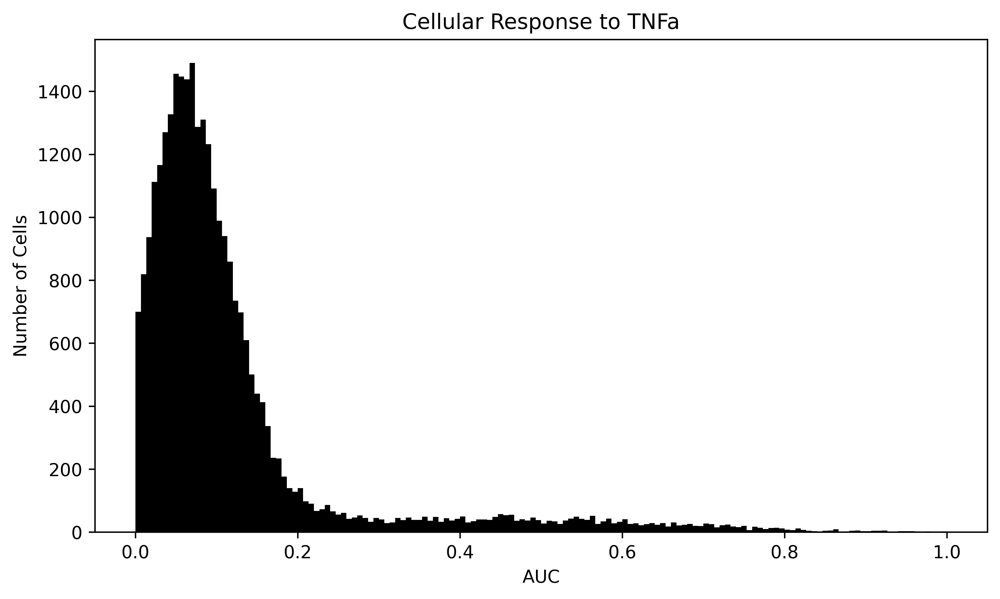

In [10]:
plt.figure(figsize=(9,5), dpi=600)
n_bins = 150
plt.title('Cellular Response to TNFa')
plt.hist(ta['AUC TNFa'], n_bins, color='black')
plt.xlabel('AUC')
plt.ylabel('Number of Cells')
plt.show()

In [11]:
ta = ta[ta['AUC TNFa'] >= 0.0]
ta

,AUC TNFa,CD120A,CD120B,Cell Type,Group,Sample
Cell_Index,,,,,,
Group_PBMCs_Sample_PBMCs 1_3794,0.065471,0.207382,1.262706,CD8 Naïve T-Cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_54922,0.255392,0.187793,1.951409,Non-Classic Monocytes,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_97680,0.104713,0.121024,1.386767,CD16bright NK-cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_121103,0.053089,0.204117,1.320582,CD16bright NK-cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_127633,0.049428,0.000000,0.935856,CD16bright NK-cells,PBMCs,PBMCs 1
...,...,...,...,...,...,...
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56393507,0.071695,0.154667,0.288585,CD4 Memory T-Cells,PBMCs RA + TNFa,PBMCs RA + TNFa 3
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56468994,0.026128,0.106357,0.202482,CD8 Memory T-Cells,PBMCs RA + TNFa,PBMCs RA + TNFa 3
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56521104,0.018340,0.179907,0.524653,B-cells,PBMCs RA + TNFa,PBMCs RA + TNFa 3


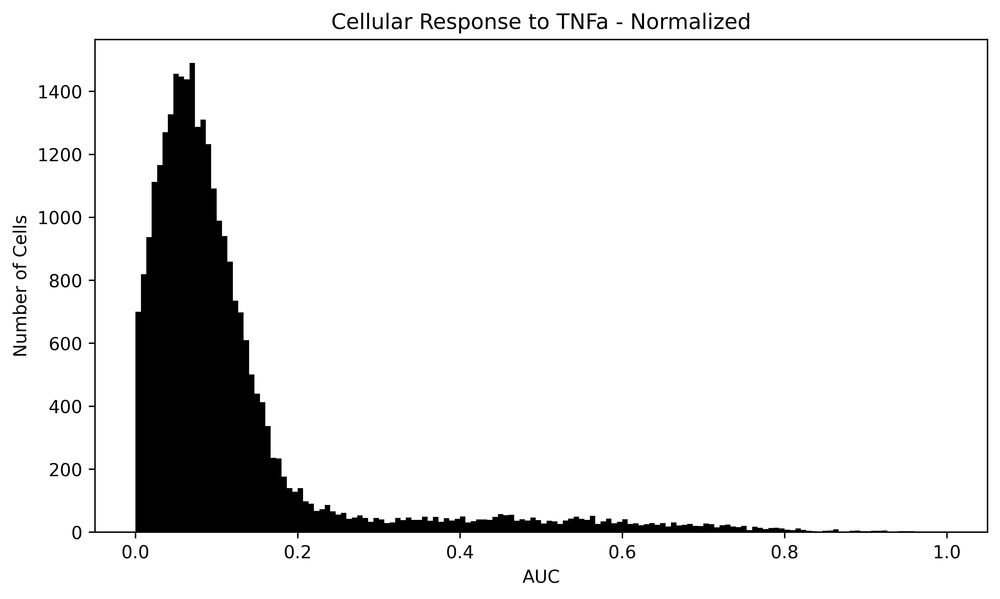

In [12]:
ta['AUC TNFa'] = (ta['AUC TNFa'] - ta['AUC TNFa'].min()) / (ta['AUC TNFa'].max() - ta['AUC TNFa'].min())
plt.figure(figsize=(9,5), dpi=600)
n_bins = 150
plt.title('Cellular Response to TNFa - Normalized')
plt.hist(ta['AUC TNFa'], n_bins, color='black')
plt.xlabel('AUC')
plt.ylabel('Number of Cells')
plt.show()

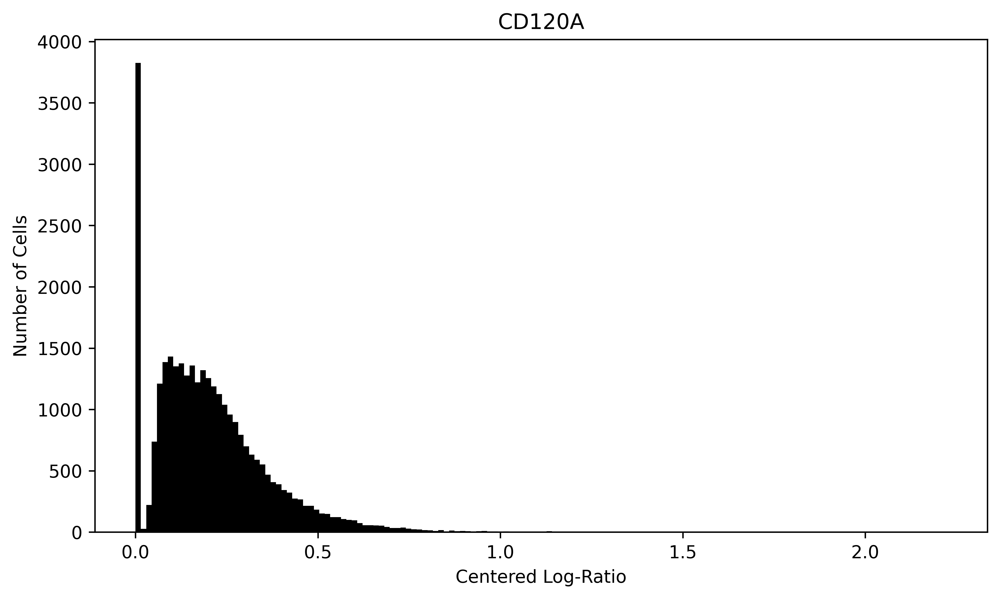

In [14]:
plt.figure(figsize=(9,5), dpi=600)
n_bins = 150
plt.title('CD120A')
plt.hist(ta['CD120A'], n_bins, color='black')
plt.xlabel('Centered Log-Ratio')
plt.ylabel('Number of Cells')
plt.show()

In [15]:
ta = ta[ta['CD120A'] > 0]
ta

,AUC TNFa,CD120A,CD120B,Cell Type,Group,Sample
Cell_Index,,,,,,
Group_PBMCs_Sample_PBMCs 1_3794,0.316969,0.207382,1.262706,CD8 Naïve T-Cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_54922,0.581391,0.187793,1.951409,Non-Classic Monocytes,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_68296,0.336498,0.122942,2.054452,NK-cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_97680,0.355416,0.121024,1.386767,NK-cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_121103,0.431485,0.204117,1.320582,NK-cells,PBMCs,PBMCs 1
...,...,...,...,...,...,...
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56393507,0.263271,0.154667,0.288585,CD4 Memory T-Cells,PBMCs RA + TNFa,PBMCs RA + TNFa 3
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56454804,0.414976,0.126410,0.575791,CD8 Naïve T-Cells,PBMCs RA + TNFa,PBMCs RA + TNFa 3
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56468994,0.379298,0.106357,0.202482,CD8 Naïve T-Cells,PBMCs RA + TNFa,PBMCs RA + TNFa 3


In [15]:
ta = ta[ta['CD120A'] < 1]
ta

,AUC TNFa,CD120A,CD120B,Cell Type,Group,Sample
Cell_Index,,,,,,
Group_PBMCs_Sample_PBMCs 1_3794,0.065471,0.207382,1.262706,CD8 Naïve T-Cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_54922,0.255392,0.187793,1.951409,Non-Classic Monocytes,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_97680,0.104713,0.121024,1.386767,CD16bright NK-cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_121103,0.053089,0.204117,1.320582,CD16bright NK-cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_127633,0.049428,0.000000,0.935856,CD16bright NK-cells,PBMCs,PBMCs 1
...,...,...,...,...,...,...
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56393507,0.071695,0.154667,0.288585,CD4 Memory T-Cells,PBMCs RA + TNFa,PBMCs RA + TNFa 3
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56468994,0.026128,0.106357,0.202482,CD8 Memory T-Cells,PBMCs RA + TNFa,PBMCs RA + TNFa 3
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56521104,0.018340,0.179907,0.524653,B-cells,PBMCs RA + TNFa,PBMCs RA + TNFa 3


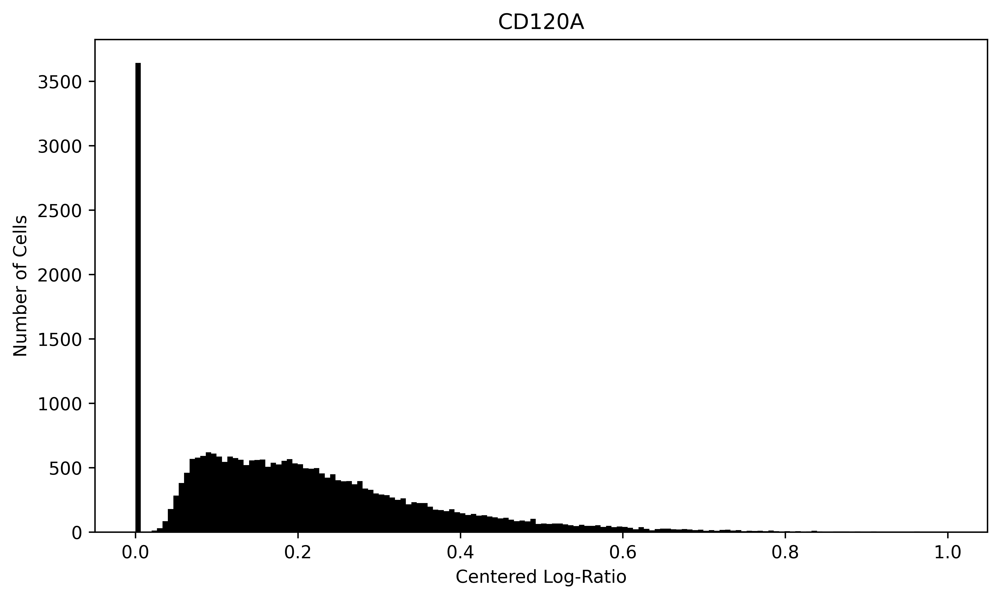

In [16]:
plt.figure(figsize=(9,5), dpi=600)
n_bins = 150
plt.title('CD120A')
plt.hist(ta['CD120A'], n_bins, color='black')
plt.xlabel('Centered Log-Ratio')
plt.ylabel('Number of Cells')
plt.show()

/var/folders/lk/54m90rgj1fqg895lxsgx1l180000gn/T/ipykernel_56325/1549646956.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ta['CD120A'] = (ta['CD120A'] - ta['CD120A'].min()) / (ta['CD120A'].max() - ta['CD120A'].min())


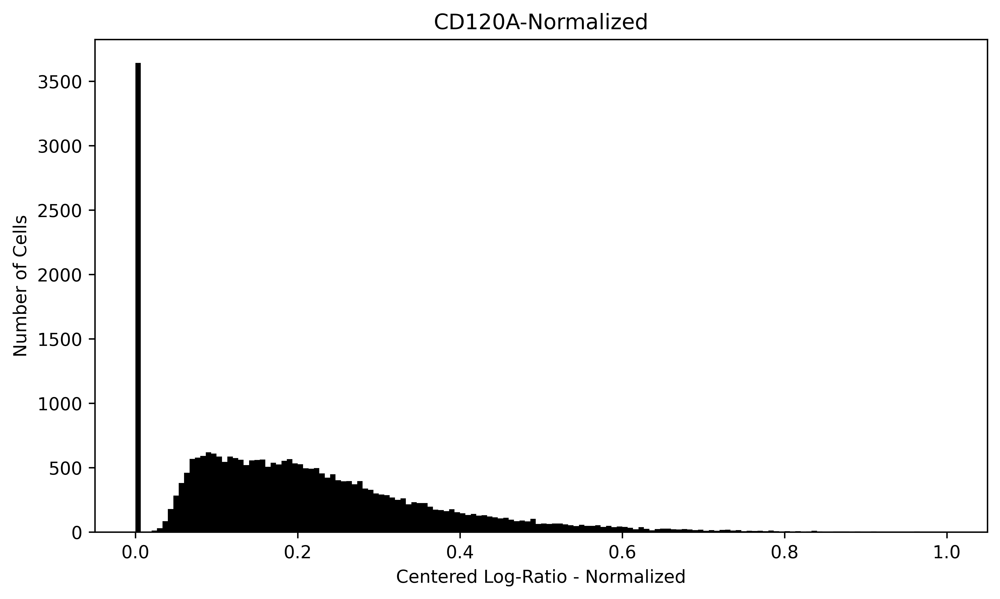

In [17]:
ta['CD120A'] = (ta['CD120A'] - ta['CD120A'].min()) / (ta['CD120A'].max() - ta['CD120A'].min())
plt.figure(figsize=(9,5), dpi=600)
n_bins = 150
plt.title('CD120A-Normalized')
plt.hist(ta['CD120A'], n_bins, color='black')
plt.xlabel('Centered Log-Ratio - Normalized')
plt.ylabel('Number of Cells')
plt.show()

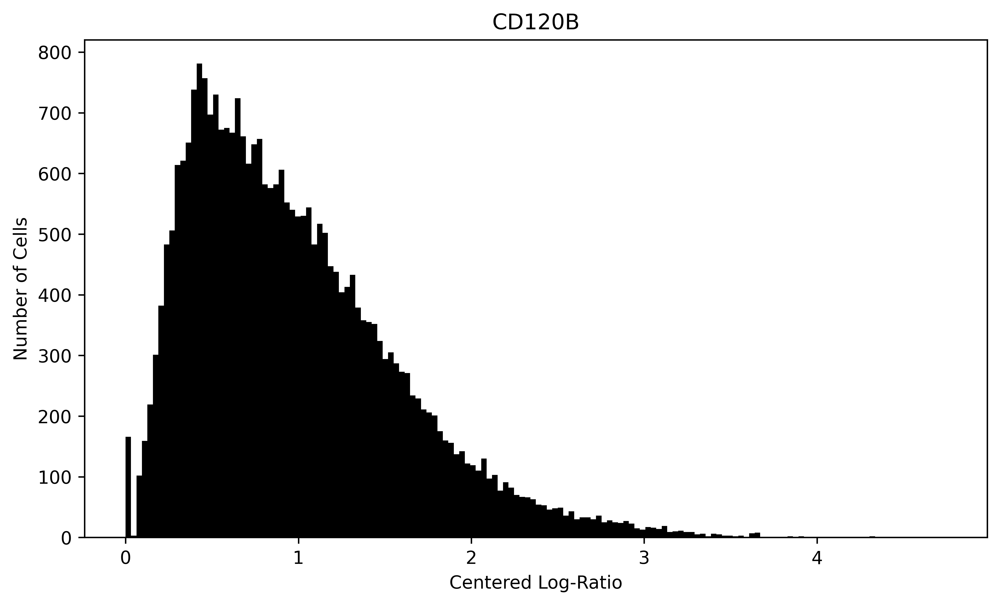

In [18]:
plt.figure(figsize=(9,5), dpi=600)
n_bins = 150
plt.title('CD120B')
plt.hist(ta['CD120B'], n_bins, color='black')
plt.xlabel('Centered Log-Ratio')
plt.ylabel('Number of Cells')
plt.show()

In [19]:
ta = ta[ta['CD120B'] < 3.65]
ta

,AUC TNFa,CD120A,CD120B,Cell Type,Group,Sample
Cell_Index,,,,,,
Group_PBMCs_Sample_PBMCs 1_3794,0.065471,0.207623,1.262706,CD8 Naïve T-Cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_54922,0.255392,0.188012,1.951409,Non-Classic Monocytes,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_97680,0.104713,0.121165,1.386767,CD16bright NK-cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_121103,0.053089,0.204354,1.320582,CD16bright NK-cells,PBMCs,PBMCs 1
Group_PBMCs_Sample_PBMCs 1_127633,0.049428,0.000000,0.935856,CD16bright NK-cells,PBMCs,PBMCs 1
...,...,...,...,...,...,...
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56393507,0.071695,0.154847,0.288585,CD4 Memory T-Cells,PBMCs RA + TNFa,PBMCs RA + TNFa 3
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56468994,0.026128,0.106481,0.202482,CD8 Memory T-Cells,PBMCs RA + TNFa,PBMCs RA + TNFa 3
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56521104,0.018340,0.180117,0.524653,B-cells,PBMCs RA + TNFa,PBMCs RA + TNFa 3


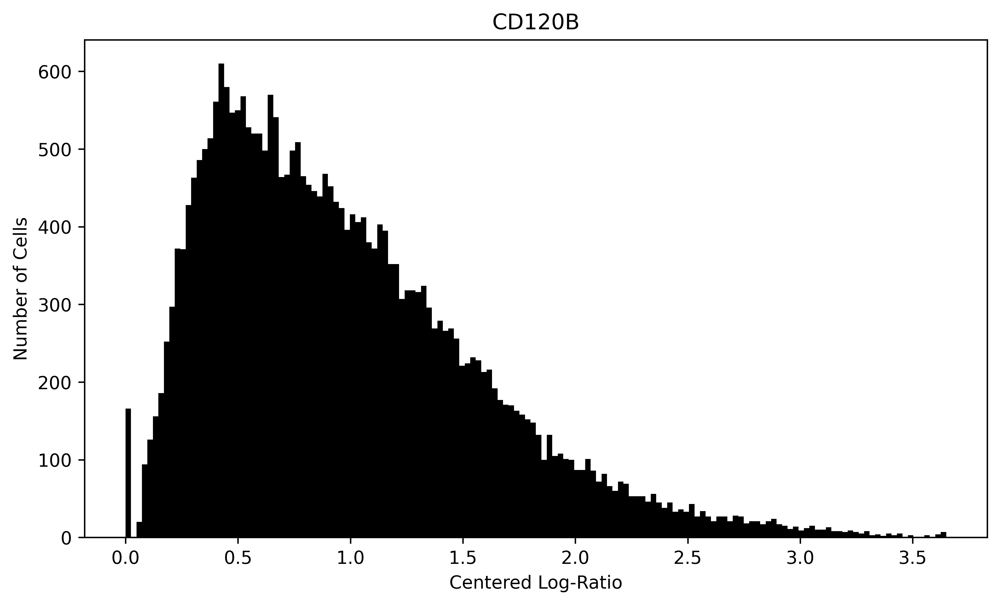

In [20]:
plt.figure(figsize=(9,5), dpi=600)
n_bins = 150
plt.title('CD120B')
plt.hist(ta['CD120B'], n_bins, color='black')
plt.xlabel('Centered Log-Ratio')
plt.ylabel('Number of Cells')
plt.show()

/var/folders/lk/54m90rgj1fqg895lxsgx1l180000gn/T/ipykernel_56325/563097541.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ta['CD120B'] = (ta['CD120B'] - ta['CD120B'].min()) / (ta['CD120B'].max() - ta['CD120B'].min())


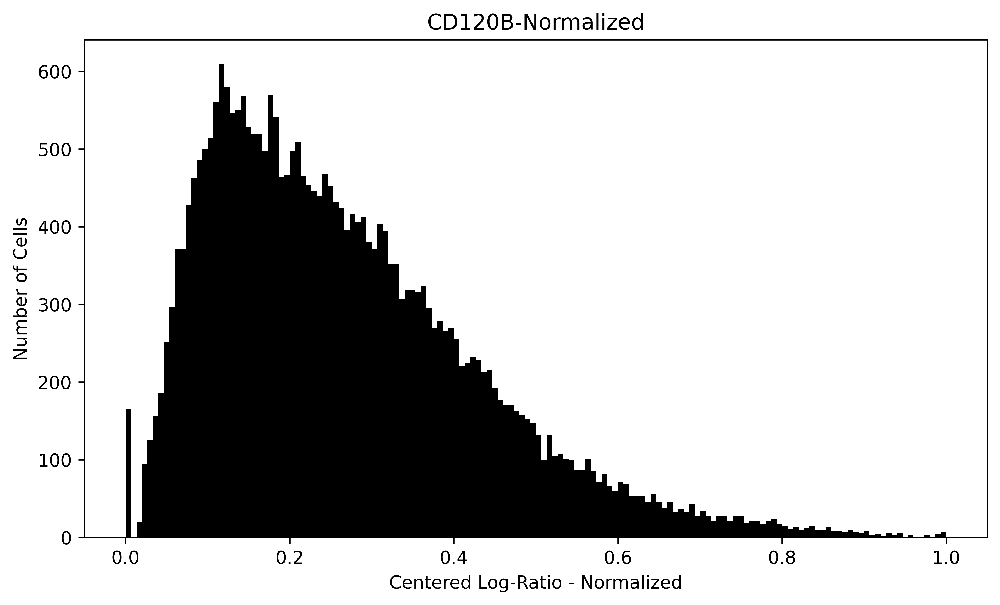

In [21]:
ta['CD120B'] = (ta['CD120B'] - ta['CD120B'].min()) / (ta['CD120B'].max() - ta['CD120B'].min())
plt.figure(figsize=(9,5), dpi=600)
n_bins = 150
plt.title('CD120B-Normalized')
plt.hist(ta['CD120B'], n_bins, color='black')
plt.xlabel('Centered Log-Ratio - Normalized')
plt.ylabel('Number of Cells')
plt.show()

In [22]:
ta_ML = pd.get_dummies(ta, columns=['Cell Type','Group','Sample'], dtype=int)
ta_ML

,AUC TNFa,CD120A,CD120B,Cell Type_B-cells,Cell Type_CD16bright NK-cells,Cell Type_CD16dim NK-cells,Cell Type_CD4 Memory T-Cells,Cell Type_CD4 NKT-cells,Cell Type_CD4 Naïve T-Cells,Cell Type_CD8 Memory T-Cells,...,Sample_PBMCs + TNFa 3,Sample_PBMCs 1,Sample_PBMCs 2,Sample_PBMCs 3,Sample_PBMCs RA + TNFa 1,Sample_PBMCs RA + TNFa 2,Sample_PBMCs RA + TNFa 3,Sample_PBMCs RA 1,Sample_PBMCs RA 2,Sample_PBMCs RA 3
Cell_Index,,,,,,,,,,,,,,,,,,,,,
Group_PBMCs_Sample_PBMCs 1_3794,0.065471,0.207623,0.346046,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_54922,0.255392,0.188012,0.534785,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_97680,0.104713,0.121165,0.380045,0,1,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_121103,0.053089,0.204354,0.361907,0,1,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_127633,0.049428,0.000000,0.256472,0,1,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56393507,0.071695,0.154847,0.079087,0,0,0,1,0,0,0,...,0,0,0,0,0,0,1,0,0,0
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56468994,0.026128,0.106481,0.055490,0,0,0,0,0,0,1,...,0,0,0,0,0,0,1,0,0,0
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_56521104,0.018340,0.180117,0.143782,1,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0


In [24]:
fig, ax = plt.subplots(figsize=(25,20), dpi=600)      
ax = sns.heatmap(ta_ML.corr().sort_values(by=['AUC TNFa'], 
                                          ascending=False, axis=0).sort_values(by=['AUC TNFa'], 
                                                                               ascending=False, axis=1), 
                 annot=True)
plt.savefig('Threshold Analysis Correlation.png', bbox_inches='tight')

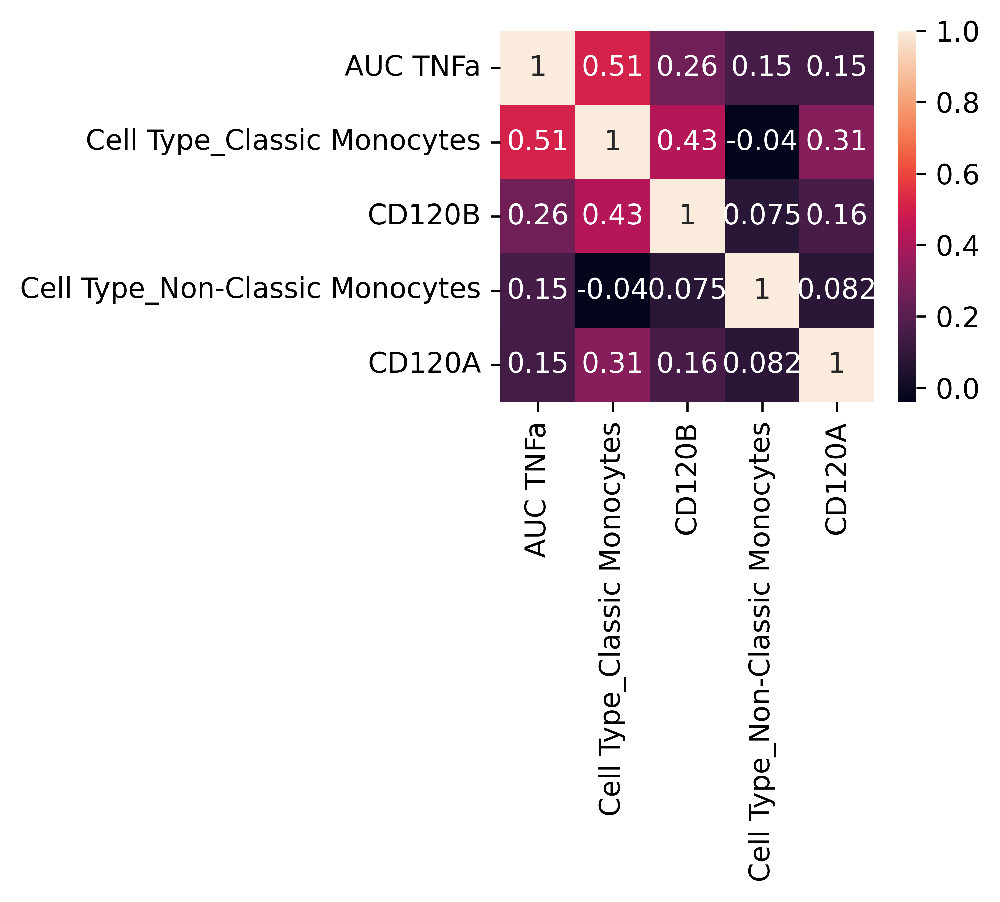

In [28]:
ta_ML_corr = ta_ML[['AUC TNFa','CD120A','CD120B','Cell Type_Classic Monocytes','Cell Type_Non-Classic Monocytes']]

fig, ax = plt.subplots(figsize=(3,2.4), dpi=600)      
ax = sns.heatmap(ta_ML_corr.corr().sort_values(by=['AUC TNFa'], 
                                          ascending=False, axis=0).sort_values(by=['AUC TNFa'], 
                                                                               ascending=False, axis=1), 
                 annot=True)
plt.savefig('Threshold Analysis Main Correlations.png', bbox_inches='tight')

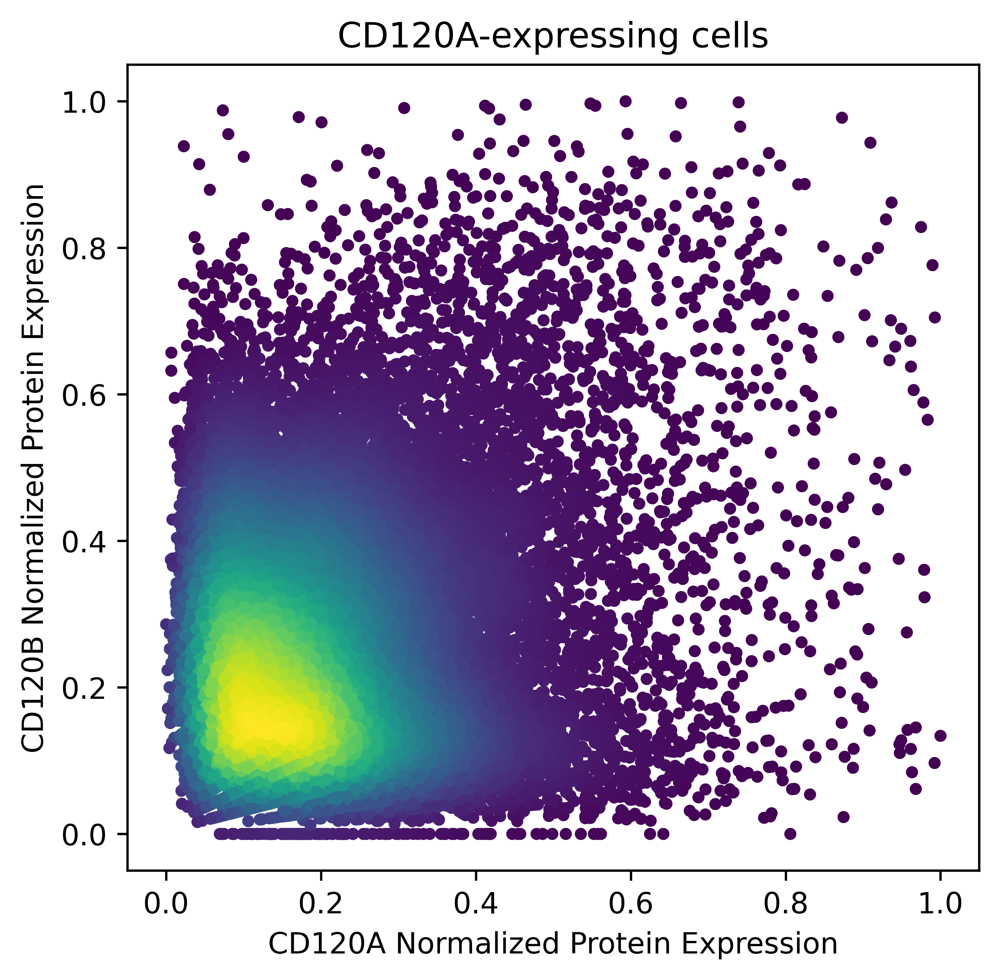

In [66]:
trim = ta_ML[ta_ML['CD120A'] <= 1.]
x = trim['CD120A']
y = trim['CD120B']

# Calculate the point density
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
# plot the data
fig, ax = plt.subplots(figsize=(5.25,5), dpi=600)
ax.scatter(x, y, c=z, s=10)
plt.title('CD120A-expressing cells')
# Labelling axes
plt.xlabel('CD120A Normalized Protein Expression')
plt.ylabel('CD120B Normalized Protein Expression')

plt.savefig('CD120A-expressing cells.png', bbox_inches='tight')

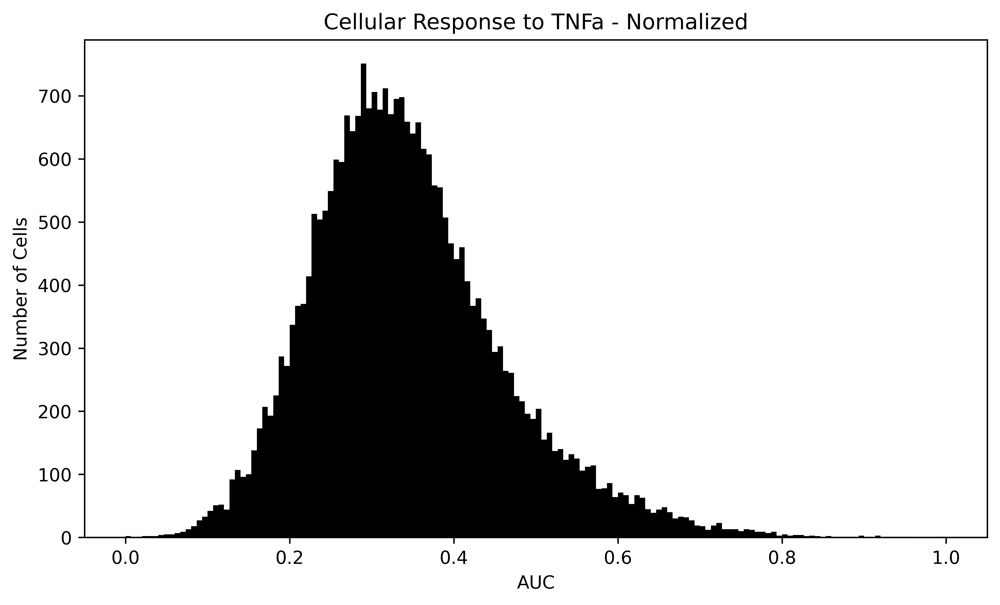

In [125]:
plt.figure(figsize=(9,5), dpi=600)
n_bins = 150
plt.title('Cellular Response to TNFa - Normalized')
plt.hist(ta_ML['AUC TNFa'], n_bins, color='black')
plt.xlabel('AUC')
plt.ylabel('Number of Cells')
plt.show()

In [25]:
activation_th = ta['AUC TNFa'].mean() + 3*ta['AUC TNFa'].std() 
activation_th

0.69680892399763

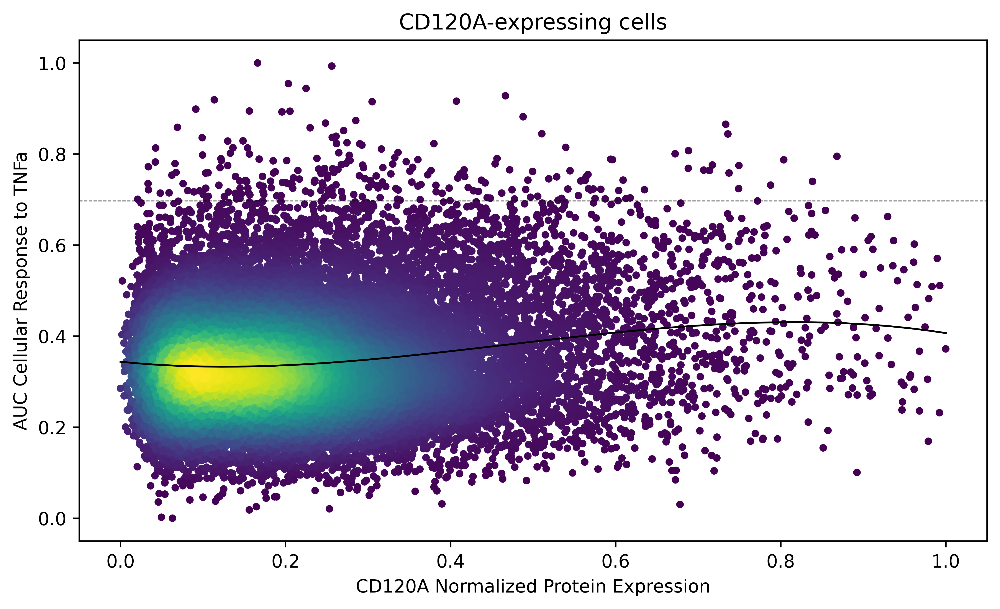

In [25]:
trim = ta_ML[ta_ML['CD120A'] <= 1.]
x = trim['CD120A']
y = trim['AUC TNFa']

CD120A_model = np.poly1d(np.polyfit(x, y, 4))
line = np.linspace(trim['CD120A'].min(), trim['CD120A'].max())

# Calculate the point density
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
# plot the data
fig, ax = plt.subplots(figsize=(9,5), dpi=600)
ax.scatter(x, y, c=z, s=10)
plt.title('CD120A-expressing cells')
plt.axhline(y = activation_th, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.plot(line, CD120A_model(line), color = 'black', linewidth = 1)
# Labelling axes
plt.xlabel('CD120A Normalized Protein Expression')
plt.ylabel('AUC Cellular Response to TNFa')

plt.savefig('CD120A-expressing cells CD120A.png', bbox_inches='tight')

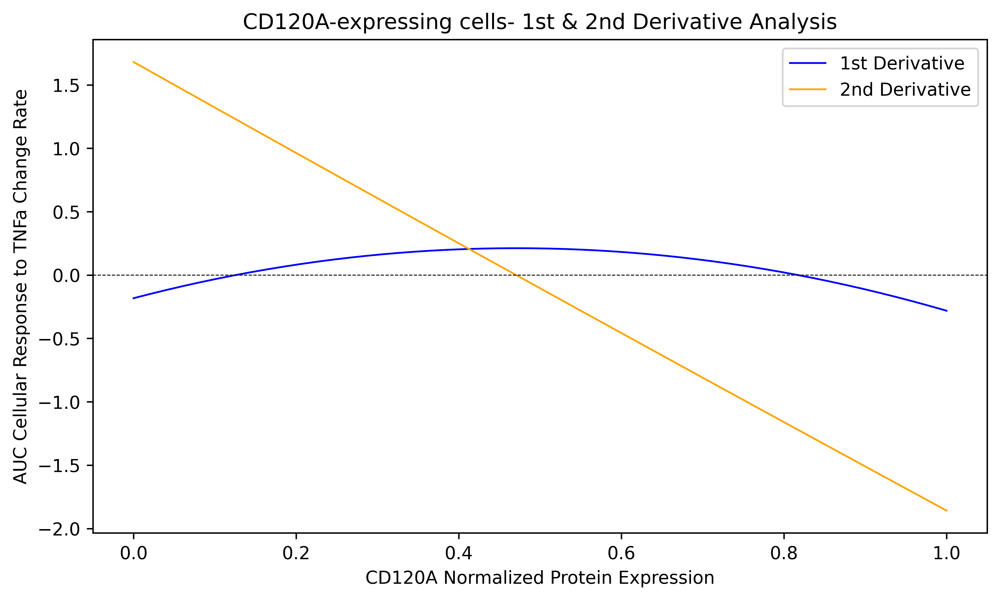

In [26]:
p1 = np.polyder(CD120A_model, 1)
p2 = np.polyder(CD120A_model, 2)

plt.figure(figsize=(9,5), dpi=600)
plt.plot(line, p1(line), color = 'blue', linewidth = 1, label="1st Derivative")
plt.plot(line, p2(line), color = 'orange', linewidth = 1, label="2nd Derivative")
plt.axhline(y = 0, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.legend(loc="upper right")

plt.title('CD120A-expressing cells- 1st & 2nd Derivative Analysis')
# Labelling axes
plt.xlabel('CD120A Normalized Protein Expression')
plt.ylabel('AUC Cellular Response to TNFa Change Rate')

plt.savefig('CD120A-expressing cells CD120A DA.png', bbox_inches='tight')

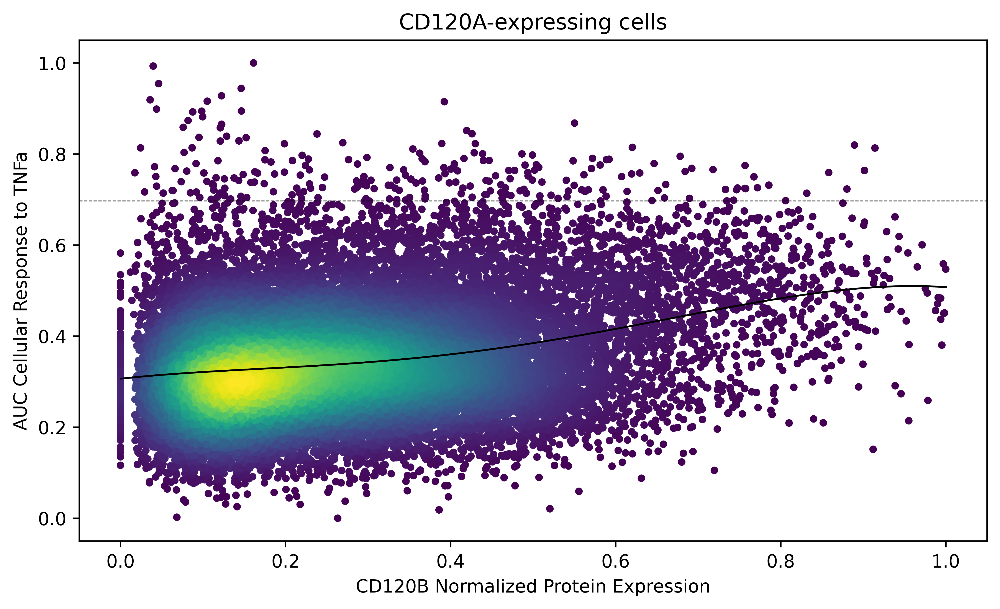

In [27]:
trim = ta_ML[ta_ML['CD120B'] <= 1.0]
x = trim['CD120B']
y = trim['AUC TNFa']

CD120B_model = np.poly1d(np.polyfit(x, y, 4))
line = np.linspace(0.001, trim['CD120B'].max())

# Calculate the point density
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
# plot the data
fig, ax = plt.subplots(figsize=(9,5), dpi=600)
ax.scatter(x, y, c=z, s=10)
plt.title('CD120A-expressing cells')
plt.axhline(y = activation_th, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.plot(line, CD120B_model(line), color = 'black', linewidth = 1)
# Labelling axes
plt.xlabel('CD120B Normalized Protein Expression')
plt.ylabel('AUC Cellular Response to TNFa')

plt.savefig('CD120A-expressing cells CD120B.png', bbox_inches='tight')

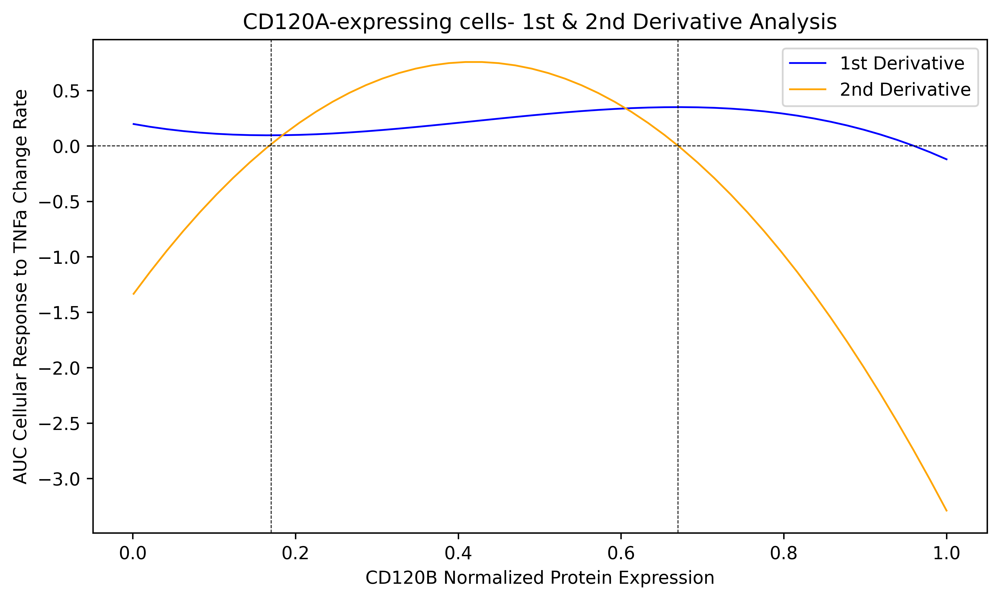

In [28]:
p1 = np.polyder(CD120B_model, 1)
p2 = np.polyder(CD120B_model, 2)

plt.figure(figsize=(9,5), dpi=600)
plt.plot(line, p1(line), color = 'blue', linewidth = 1, label="1st Derivative")
plt.plot(line, p2(line), color = 'orange', linewidth = 1, label="2nd Derivative")
plt.axvline(x = 0.17, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axvline(x = 0.67, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axhline(y = 0, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.legend(loc="upper right")

plt.title('CD120A-expressing cells- 1st & 2nd Derivative Analysis')
# Labelling axes
plt.xlabel('CD120B Normalized Protein Expression')
plt.ylabel('AUC Cellular Response to TNFa Change Rate')

plt.savefig('CD120A-expressing cells CD120B DA.png', bbox_inches='tight')

In [72]:
ta_ML_activated = ta_ML[ta_ML['AUC TNFa'] >= activation_th]
ta_ML_activated

,AUC TNFa,CD120A,CD120B,Cell Type_B-cells,Cell Type_CD4 Memory T-Cells,Cell Type_CD4 NKT-cells,Cell Type_CD4 Naïve T-Cells,Cell Type_CD8 Memory T-Cells,Cell Type_CD8 NKT-cells,Cell Type_CD8 Naïve T-Cells,...,Sample_PBMCs + TNFa 3,Sample_PBMCs 1,Sample_PBMCs 2,Sample_PBMCs 3,Sample_PBMCs RA + TNFa 1,Sample_PBMCs RA + TNFa 2,Sample_PBMCs RA + TNFa 3,Sample_PBMCs RA 1,Sample_PBMCs RA 2,Sample_PBMCs RA 3
Cell_Index,,,,,,,,,,,,,,,,,,,,,
Group_PBMCs_Sample_PBMCs 1_2034439,0.731154,0.245327,0.549734,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_11728483,0.790462,0.238023,0.571959,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_16919323,0.741656,0.562961,0.294130,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_19809727,0.764602,0.706762,0.501765,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_22448007,0.867825,0.248380,0.550194,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_24196970,0.751834,0.309844,0.493907,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_40268126,0.739858,0.838517,0.104686,0,0,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_40585178,0.717127,0.382477,0.185340,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0


In [75]:
ta_ML_activated.describe().T
# Classic Monocytes comprised 80.6% of the TNFa-activated cells
# Non-Classic Monocytes comprised 12.4% of the TNFa-activated cells

,count,mean,std,min,25%,50%,75%,max
AUC TNFa,258.0,0.753966,0.057653,0.689937,0.713917,0.738779,0.777595,1.000000
CD120A,258.0,0.318568,0.187648,0.020927,0.172590,0.275361,0.440720,0.868157
CD120B,258.0,0.354858,0.216261,0.017467,0.158792,0.345400,0.493821,0.914214
Cell Type_B-cells,258.0,0.003876,0.062257,0.000000,0.000000,0.000000,0.000000,1.000000
Cell Type_CD4 Memory T-Cells,258.0,0.007752,0.087874,0.000000,0.000000,0.000000,0.000000,1.000000
Cell Type_CD4 NKT-cells,258.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Cell Type_CD4 Naïve T-Cells,258.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Cell Type_CD8 Memory T-Cells,258.0,0.011628,0.107412,0.000000,0.000000,0.000000,0.000000,1.000000
Cell Type_CD8 NKT-cells,258.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Cell Type_CD8 Naïve T-Cells,258.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [23]:
ta_ML_Cm = ta_ML[ta_ML['Cell Type_Classic Monocytes'] == 1]
ta_ML_Cm

,AUC TNFa,CD120A,CD120B,Cell Type_B-cells,Cell Type_CD16bright NK-cells,Cell Type_CD16dim NK-cells,Cell Type_CD4 Memory T-Cells,Cell Type_CD4 NKT-cells,Cell Type_CD4 Naïve T-Cells,Cell Type_CD8 Memory T-Cells,...,Sample_PBMCs + TNFa 3,Sample_PBMCs 1,Sample_PBMCs 2,Sample_PBMCs 3,Sample_PBMCs RA + TNFa 1,Sample_PBMCs RA + TNFa 2,Sample_PBMCs RA + TNFa 3,Sample_PBMCs RA 1,Sample_PBMCs RA 2,Sample_PBMCs RA 3
Cell_Index,,,,,,,,,,,,,,,,,,,,,
Group_PBMCs_Sample_PBMCs 1_294188,0.236886,0.437643,0.815381,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_1198653,0.431900,0.610097,0.710694,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_2034439,0.540541,0.260292,0.549734,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_3366978,0.387665,0.741150,0.536127,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_3654198,0.086407,0.621351,0.278542,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_53064202,0.428272,0.202972,0.445576,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_53912197,0.475336,0.284973,0.087537,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_54026915,0.329550,0.342263,0.379150,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0


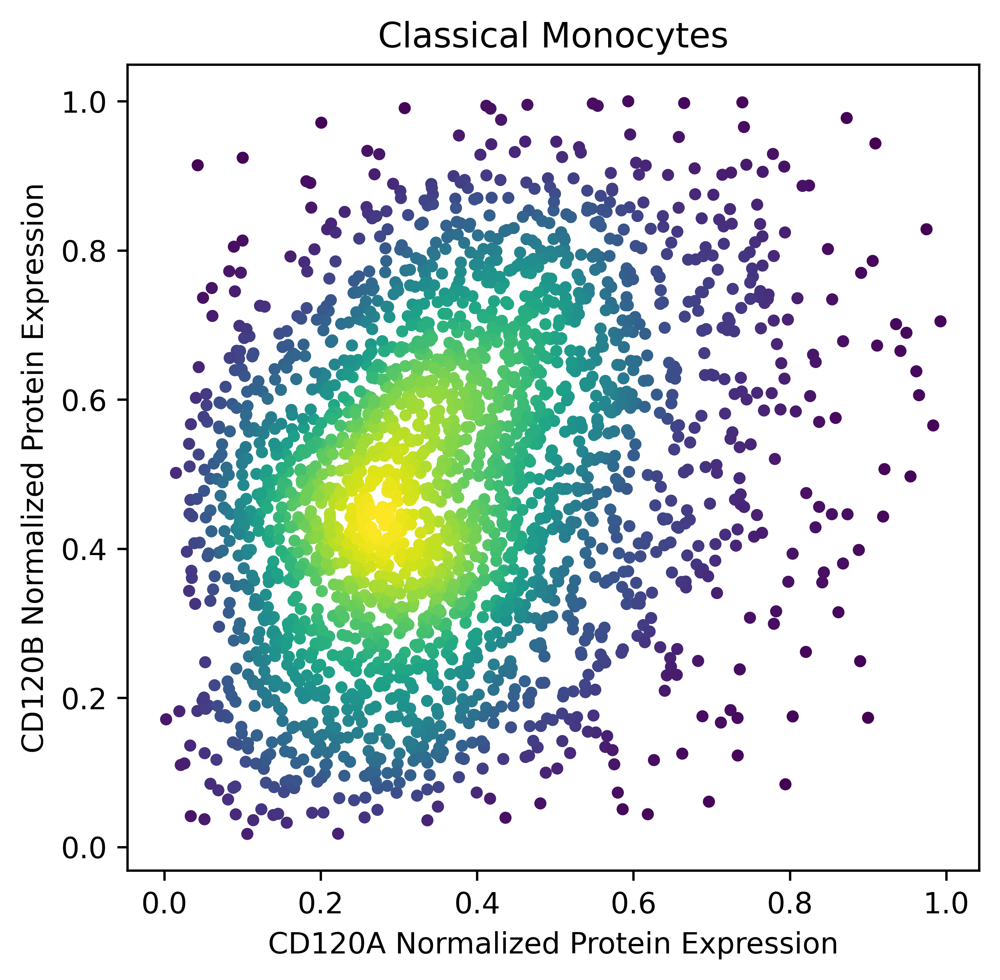

In [119]:
trim = ta_ML_Cm[ta_ML_Cm['CD120A'] <= 1.]
x = trim['CD120A']
y = trim['CD120B']

# Calculate the point density
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
# plot the data
fig, ax = plt.subplots(figsize=(5.25,5), dpi=600)
ax.scatter(x, y, c=z, s=10)
plt.title('Classical Monocytes')
# Labelling axes
plt.xlabel('CD120A Normalized Protein Expression')
plt.ylabel('CD120B Normalized Protein Expression')

plt.savefig('Classical Monocytes.png', bbox_inches='tight')

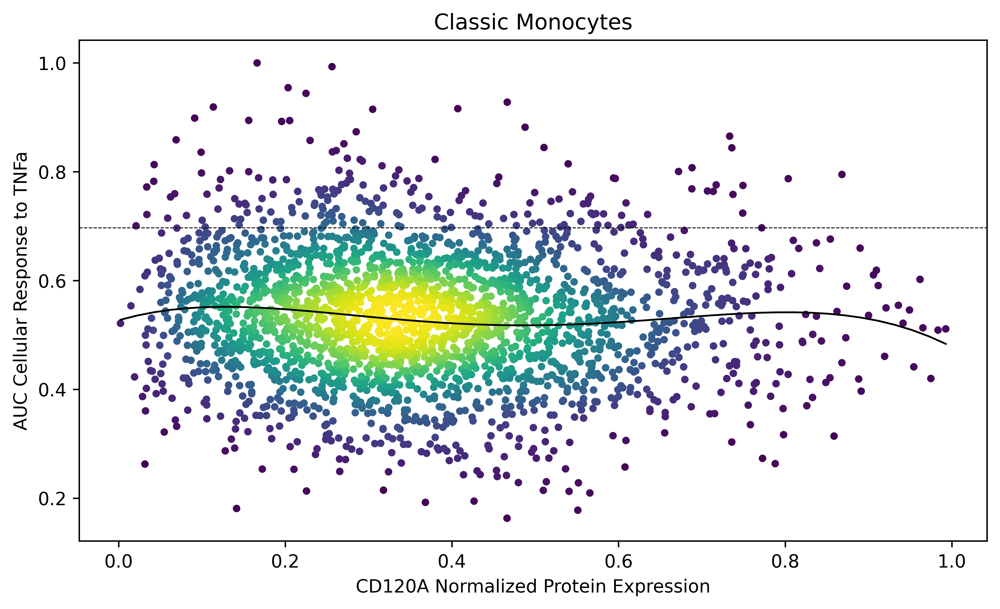

In [24]:
trim = ta_ML_Cm[ta_ML_Cm['CD120A'] <= 1.]
x = trim['CD120A']
y = trim['AUC TNFa']

CD120A_Mono_model = np.poly1d(np.polyfit(x, y, 4))
line = np.linspace(trim['CD120A'].min(), trim['CD120A'].max())

# Calculate the point density
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
# plot the data
fig, ax = plt.subplots(figsize=(9,5), dpi=600)
ax.scatter(x, y, c=z, s=10)
plt.title('Classic Monocytes')
plt.axhline(y = activation_th, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.plot(line, CD120A_Mono_model(line), color = 'black', linewidth = 1)
# Labelling axes
plt.xlabel('CD120A Normalized Protein Expression')
plt.ylabel('AUC Cellular Response to TNFa')

plt.savefig('Classic Monocytes CD120A.png', bbox_inches='tight')

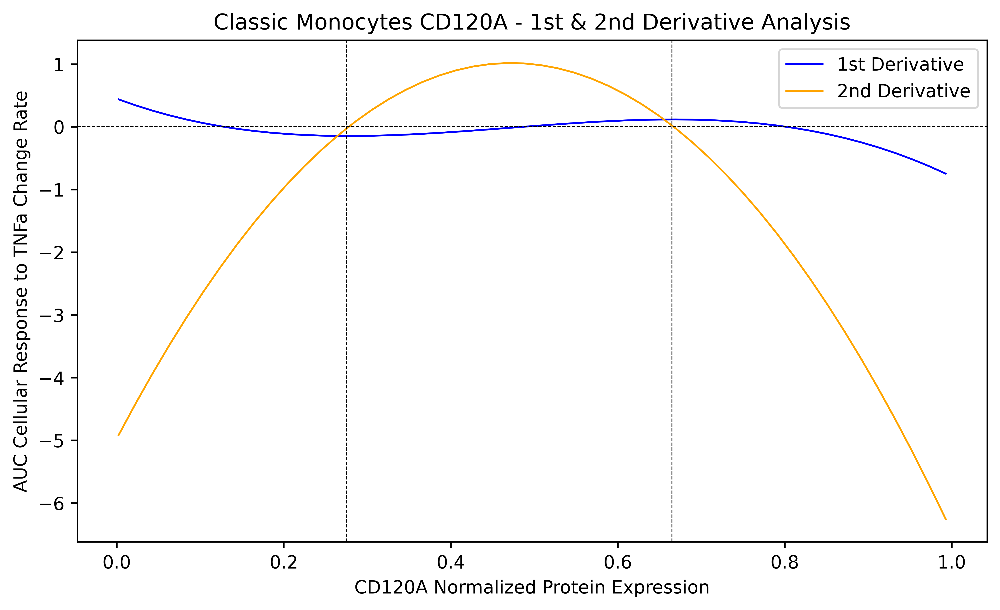

In [81]:
p1 = np.polyder(CD120A_Mono_model, 1)
p2 = np.polyder(CD120A_Mono_model, 2)

plt.figure(figsize=(9,5), dpi=600)
plt.plot(line, p1(line), color = 'blue', linewidth = 1, label="1st Derivative")
plt.plot(line, p2(line), color = 'orange', linewidth = 1, label="2nd Derivative")
plt.axvline(x = 0.275, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axvline(x = 0.665, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axhline(y = 0, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.legend(loc="upper right")

plt.title('Classic Monocytes CD120A - 1st & 2nd Derivative Analysis')
# Labelling axes
plt.xlabel('CD120A Normalized Protein Expression')
plt.ylabel('AUC Cellular Response to TNFa Change Rate')

plt.savefig('Classic Monocytes CD120A DA.png', bbox_inches='tight')

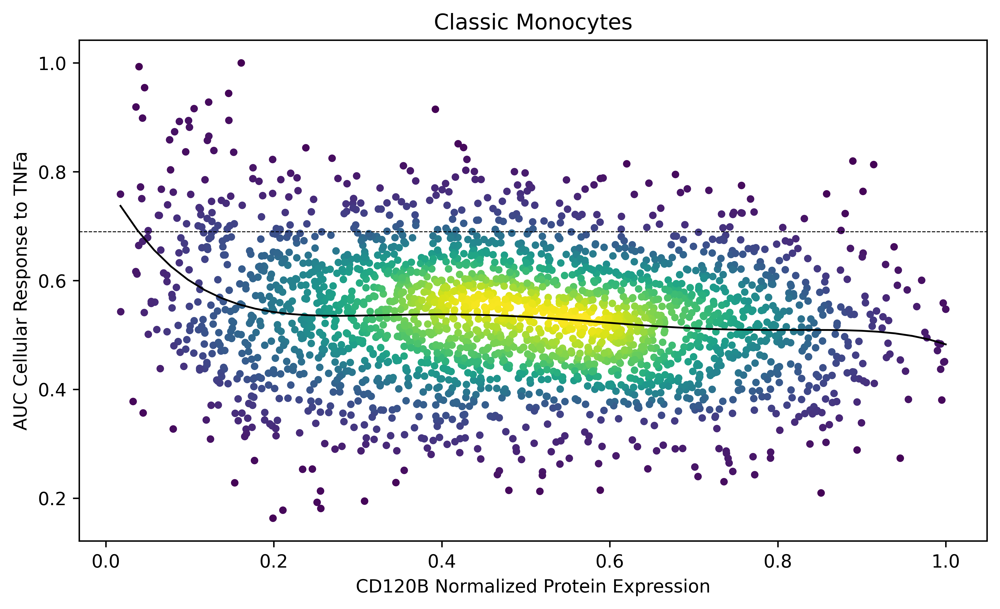

In [82]:
trim = ta_ML_Cm[ta_ML_Cm['CD120B'] <= 1.]
x = trim['CD120B']
y = trim['AUC TNFa']

# Model
CD120B_Mono_model = np.poly1d(np.polyfit(x, y, 5))
line = np.linspace(trim['CD120B'].min(), trim['CD120B'].max())

# Calculate the point density
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
# plot the data
fig, ax = plt.subplots(figsize=(9,5), dpi=600)
ax.scatter(x, y, c=z, s=10)
plt.title('Classic Monocytes')
plt.axhline(y = activation_th, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.plot(line, CD120B_Mono_model(line), color = 'black', linewidth = 1)

# Labelling axes
plt.xlabel('CD120B Normalized Protein Expression')
plt.ylabel('AUC Cellular Response to TNFa')

plt.savefig('Classic Monocytes CD120B.png', bbox_inches='tight')

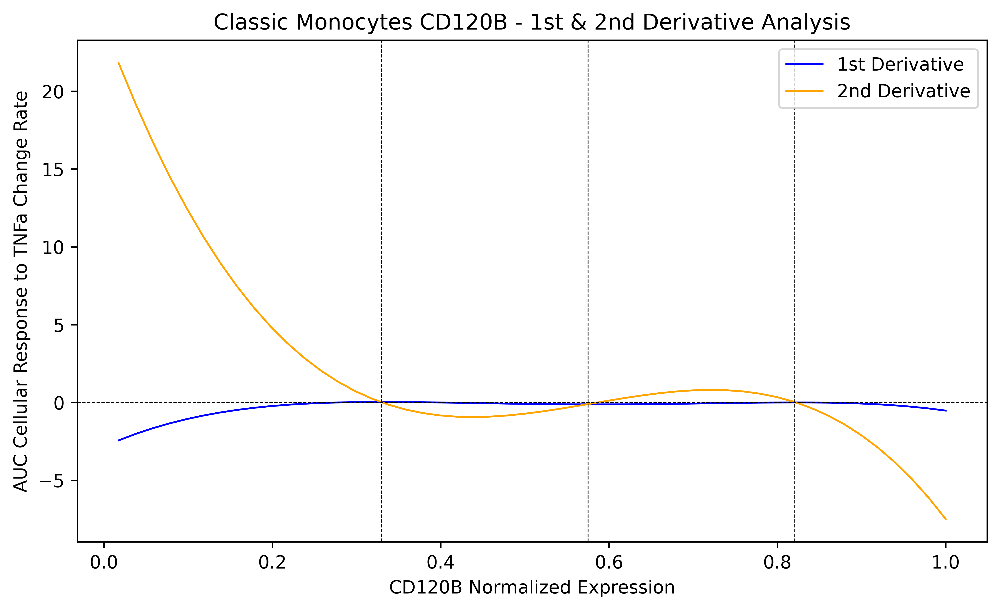

In [88]:
p1 = np.polyder(CD120B_Mono_model, 1)
p2 = np.polyder(CD120B_Mono_model, 2)

plt.figure(figsize=(9,5), dpi=600)
plt.plot(line, p1(line), color = 'blue', linewidth = 1, label="1st Derivative")
plt.plot(line, p2(line), color = 'orange', linewidth = 1, label="2nd Derivative")
plt.axvline(x = 0.33, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axvline(x = 0.575, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axvline(x = 0.82, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axhline(y = 0, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.legend(loc="upper right")

plt.title('Classic Monocytes CD120B - 1st & 2nd Derivative Analysis')
# Labelling axes
plt.xlabel('CD120B Normalized Expression')
plt.ylabel('AUC Cellular Response to TNFa Change Rate')

plt.savefig('Classic Monocytes CD120B DA.png', bbox_inches='tight')

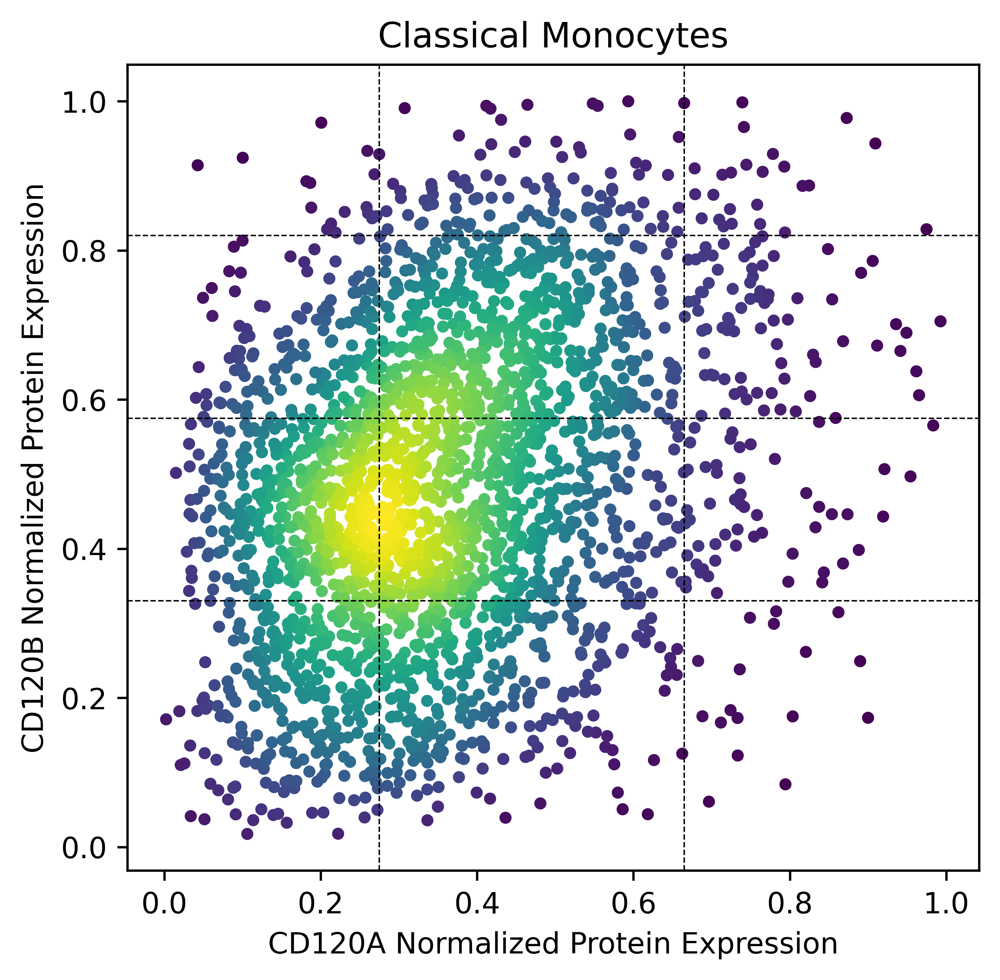

In [130]:
trim = ta_ML_Cm[ta_ML_Cm['CD120A'] <= 1.]
x = trim['CD120A']
y = trim['CD120B']

# Calculate the point density
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
# plot the data
fig, ax = plt.subplots(figsize=(5.25,5), dpi=600)
ax.scatter(x, y, c=z, s=10)
plt.title('Classical Monocytes')

plt.axvline(x = 0.275, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axvline(x = 0.665, color = 'black', linewidth = 0.5, linestyle='dashed')

plt.axhline(y = 0.33, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axhline(y = 0.575, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axhline(y = 0.82, color = 'black', linewidth = 0.5, linestyle='dashed')

# Labelling axes
plt.xlabel('CD120A Normalized Protein Expression')
plt.ylabel('CD120B Normalized Protein Expression')

plt.savefig('Classical Monocytes DA.png', bbox_inches='tight')

In [26]:
ta_ML_Cm_counts = pd.merge(ta_ML_Cm,AbSeq_counts,how='left',left_index=True, right_index=True)
ta_ML_Cm_counts = ta_ML_Cm_counts.rename(columns={'CD120A-TNFRSF1A-AHS0439-pAbO' : 'CD120A AbSeq Molecules',
                                                  'CD120b-TNFRSF1B-AHS0421-pAbO' : 'CD120B AbSeq Molecules'})
ta_ML_Cm_counts = ta_ML_Cm_counts.fillna(0)
ta_ML_Cm_counts.describe().T

,count,mean,std,min,25%,50%,75%,max
AUC TNFa,2561.0,0.497211,0.176862,0.000699,0.371721,0.489882,0.618926,1.000000
CD120A,2561.0,0.371404,0.182429,0.000000,0.242304,0.355277,0.483934,0.992891
CD120B,2561.0,0.484193,0.209535,0.017467,0.330042,0.479388,0.638199,1.000000
Cell Type_B-cells,2561.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Cell Type_CD16bright NK-cells,2561.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Cell Type_CD16dim NK-cells,2561.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Cell Type_CD4 Memory T-Cells,2561.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Cell Type_CD4 NKT-cells,2561.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Cell Type_CD4 Naïve T-Cells,2561.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Cell Type_CD8 Memory T-Cells,2561.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


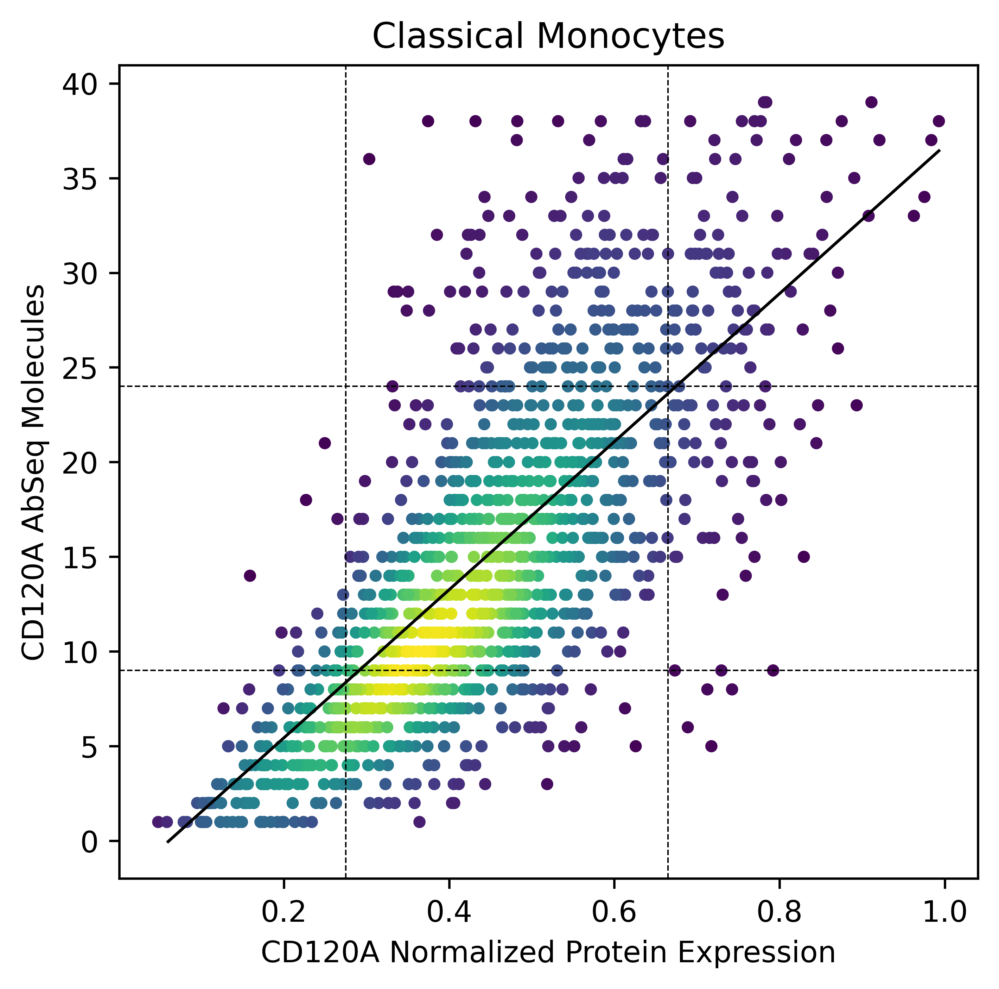

In [27]:
trim = ta_ML_Cm_counts[ta_ML_Cm_counts['CD120A AbSeq Molecules'] > 0]
trim = trim[trim['CD120A AbSeq Molecules'] < 40]

# trim['CD120A AbSeq Molecules'] = np.log10(trim['CD120A AbSeq Molecules'])
x = trim['CD120A']
y = trim['CD120A AbSeq Molecules']

# Model
Model = np.poly1d(np.polyfit(x, y, 1))
line = np.linspace(0.06, trim['CD120A'].max())

# Calculate the point density
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
# plot the data
fig, ax = plt.subplots(figsize=(5.25,5), dpi=600)
ax.scatter(x, y, c=z, s=10)
plt.title('Classical Monocytes')

plt.plot(line, Model(line), color = 'black', linewidth = 1)

plt.axvline(x = 0.275, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axvline(x = 0.665, color = 'black', linewidth = 0.5, linestyle='dashed')

plt.axhline(y = 9, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axhline(y = 24, color = 'black', linewidth = 0.5, linestyle='dashed')

# Labelling axes
plt.xlabel('CD120A Normalized Protein Expression')
plt.ylabel('CD120A AbSeq Molecules')

plt.savefig('Classical Monocytes CD120A Counts.png', bbox_inches='tight')

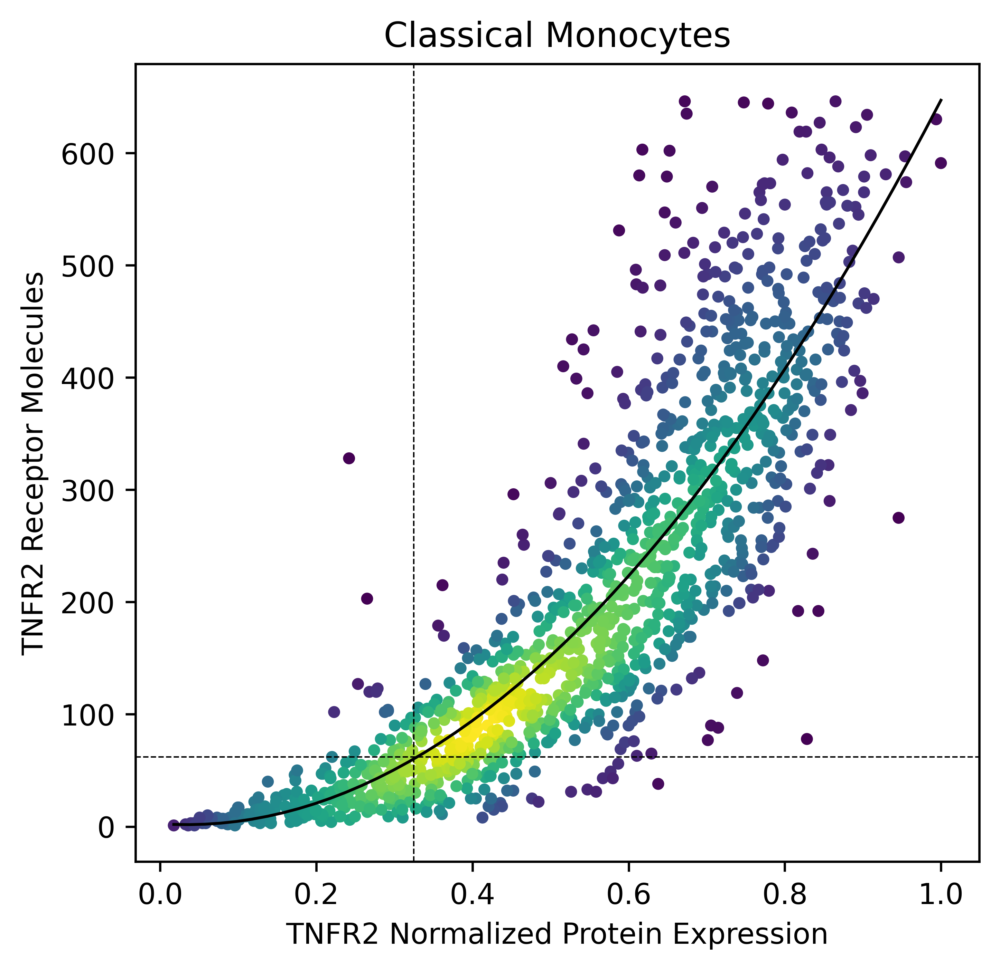

In [53]:
# Model
Model = np.poly1d(np.polyfit(x, y, 2))
line = np.linspace(trim['CD120B'].min(), trim['CD120B'].max())

trim = ta_ML_Cm_counts[ta_ML_Cm_counts['CD120B AbSeq Molecules'] > 0]
trim = trim[trim['CD120B AbSeq Molecules'] < 650]

x = trim['CD120B']
y = trim['CD120B AbSeq Molecules']

# Calculate the point density
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
# plot the data
fig, ax = plt.subplots(figsize=(5.25,5), dpi=600)
ax.scatter(x, y, c=z, s=10)
plt.title('Classical Monocytes')

plt.plot(line, Model(line), color = 'black', linewidth = 1)

plt.axvline(x = 0.325, color = 'black', linewidth = 0.5, linestyle='dashed')

plt.axhline(y = 62, color = 'black', linewidth = 0.5, linestyle='dashed')


# Labelling axes
plt.xlabel('TNFR2 Normalized Protein Expression')
plt.ylabel('TNFR2 Receptor Molecules')

plt.savefig('Classical Monocytes TNFR2 Receptor Counts.png', bbox_inches='tight')

In [89]:
ta_ML_nCm = ta_ML[ta_ML['Cell Type_Non-Classic Monocytes'] == 1]
ta_ML_nCm

,AUC TNFa,CD120A,CD120B,Cell Type_B-cells,Cell Type_CD4 Memory T-Cells,Cell Type_CD4 NKT-cells,Cell Type_CD4 Naïve T-Cells,Cell Type_CD8 Memory T-Cells,Cell Type_CD8 NKT-cells,Cell Type_CD8 Naïve T-Cells,...,Sample_PBMCs + TNFa 3,Sample_PBMCs 1,Sample_PBMCs 2,Sample_PBMCs 3,Sample_PBMCs RA + TNFa 1,Sample_PBMCs RA + TNFa 2,Sample_PBMCs RA + TNFa 3,Sample_PBMCs RA 1,Sample_PBMCs RA 2,Sample_PBMCs RA 3
Cell_Index,,,,,,,,,,,,,,,,,,,,,
Group_PBMCs_Sample_PBMCs 1_54922,0.581391,0.171584,0.534785,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_3456232,0.466767,0.410181,0.597889,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_5910447,0.445727,0.264645,0.076433,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_6424136,0.265322,0.269084,0.569368,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_6903466,0.288160,0.168667,0.635969,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_48850815,0.548842,0.156057,0.437339,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_53762279,0.691339,0.165226,0.218930,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
Group_PBMCs RA + TNFa_Sample_PBMCs RA + TNFa 3_54901302,0.123400,0.057544,0.193839,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0


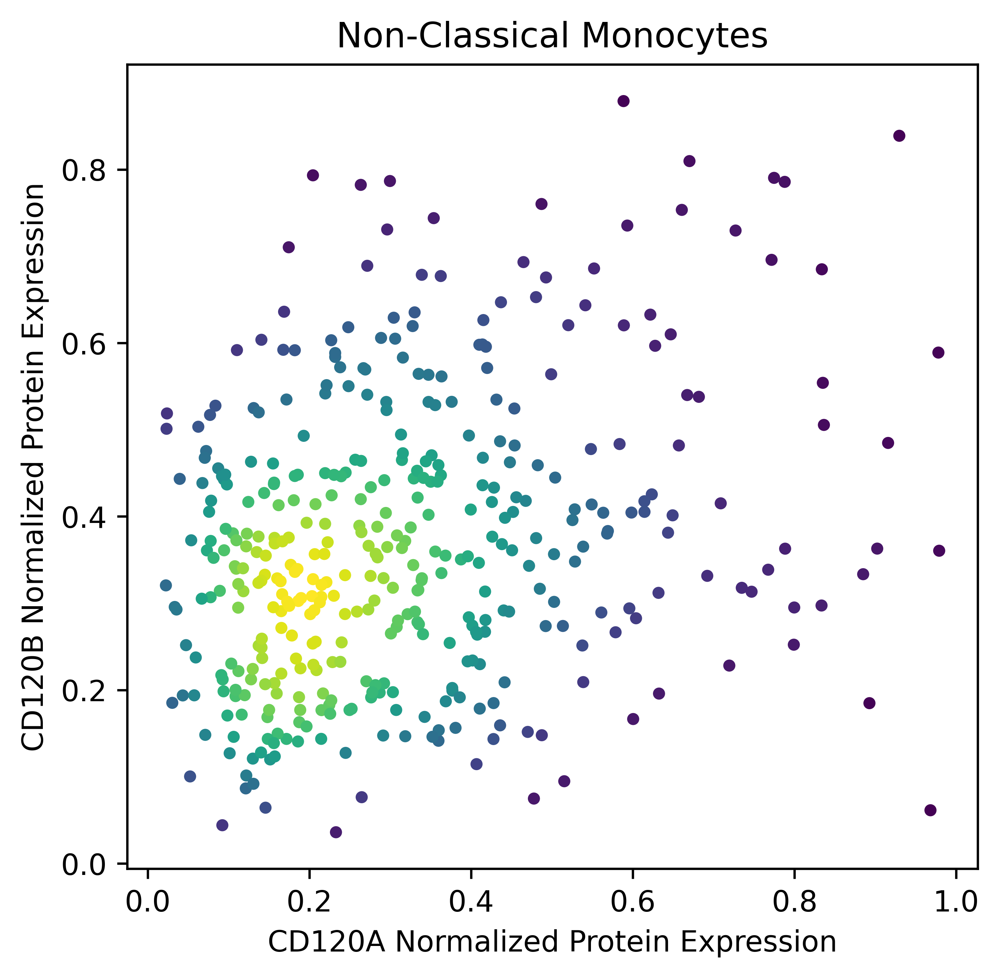

In [118]:
trim = ta_ML_nCm[ta_ML_nCm['CD120A'] <= 1.]
x = trim['CD120A']
y = trim['CD120B']

# Calculate the point density
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
# plot the data
fig, ax = plt.subplots(figsize=(5.25,5), dpi=600)
ax.scatter(x, y, c=z, s=10)
plt.title('Non-Classical Monocytes')
# Labelling axes
plt.xlabel('CD120A Normalized Protein Expression')
plt.ylabel('CD120B Normalized Protein Expression')

plt.savefig('Non-Classical Monocytes.png', bbox_inches='tight')

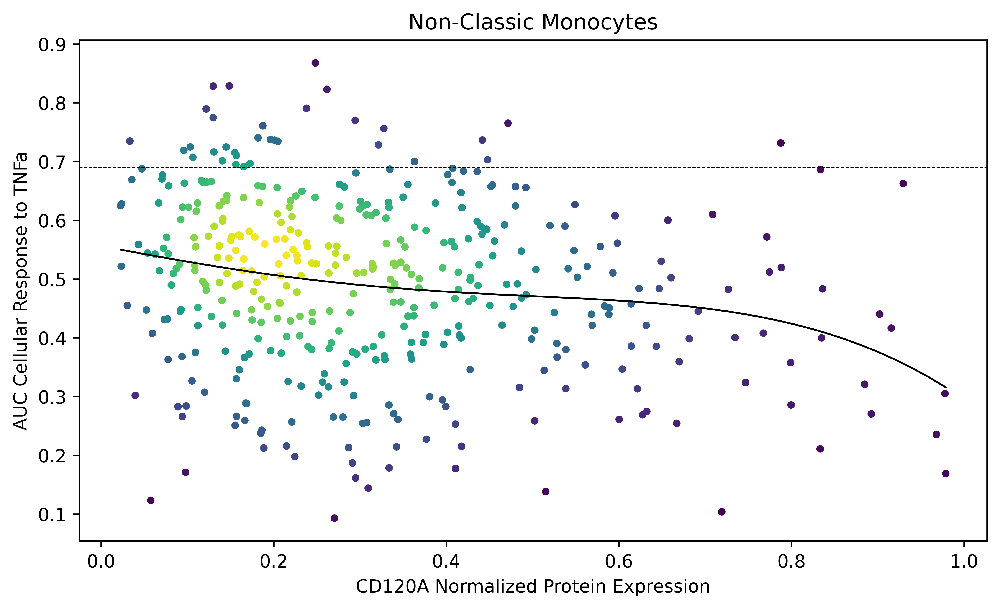

In [90]:
trim = ta_ML_nCm[ta_ML_nCm['CD120A'] <= 1.]
x = trim['CD120A']
y = trim['AUC TNFa']

CD120A_Mono_model = np.poly1d(np.polyfit(x, y, 4))
line = np.linspace(trim['CD120A'].min(), trim['CD120A'].max())

# Calculate the point density
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
# plot the data
fig, ax = plt.subplots(figsize=(9,5), dpi=600)
ax.scatter(x, y, c=z, s=10)
plt.title('Non-Classic Monocytes')
plt.axhline(y = activation_th, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.plot(line, CD120A_Mono_model(line), color = 'black', linewidth = 1)

# Labelling axes
plt.xlabel('CD120A Normalized Protein Expression')
plt.ylabel('AUC Cellular Response to TNFa')

plt.savefig('Non-Classic Monocytes CD120A.png', bbox_inches='tight')

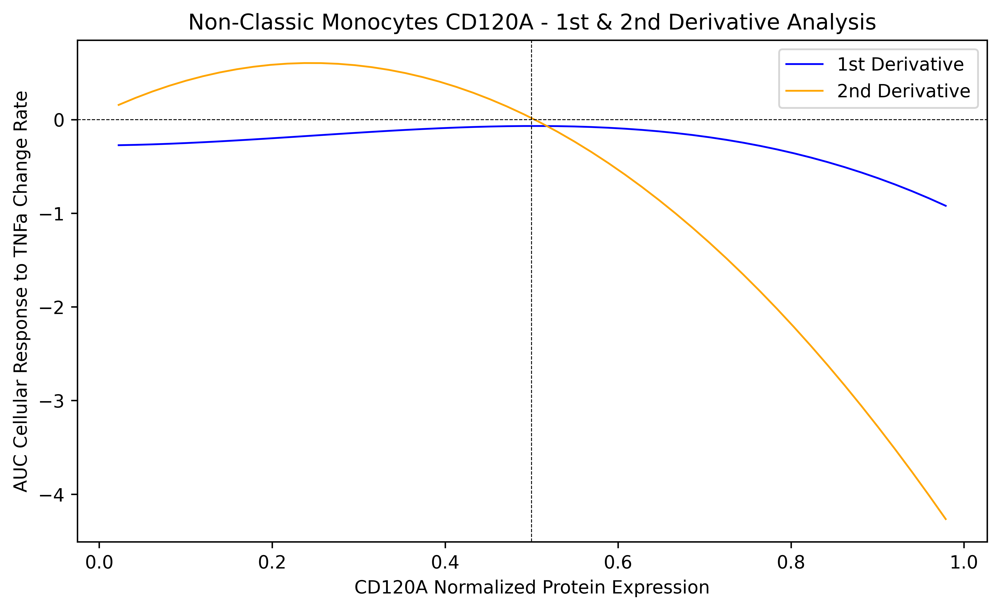

In [95]:
p1 = np.polyder(CD120A_Mono_model, 1)
p2 = np.polyder(CD120A_Mono_model, 2)

plt.figure(figsize=(9,5), dpi=600)
plt.plot(line, p1(line), color = 'blue', linewidth = 1, label="1st Derivative")
plt.plot(line, p2(line), color = 'orange', linewidth = 1, label="2nd Derivative")
plt.axvline(x = 0.5, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axhline(y = 0, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.legend(loc="upper right")

plt.title('Non-Classic Monocytes CD120A - 1st & 2nd Derivative Analysis')
# Labelling axes
plt.xlabel('CD120A Normalized Protein Expression')
plt.ylabel('AUC Cellular Response to TNFa Change Rate')

plt.savefig('Non-Classic Monocytes CD120A DA.png', bbox_inches='tight')

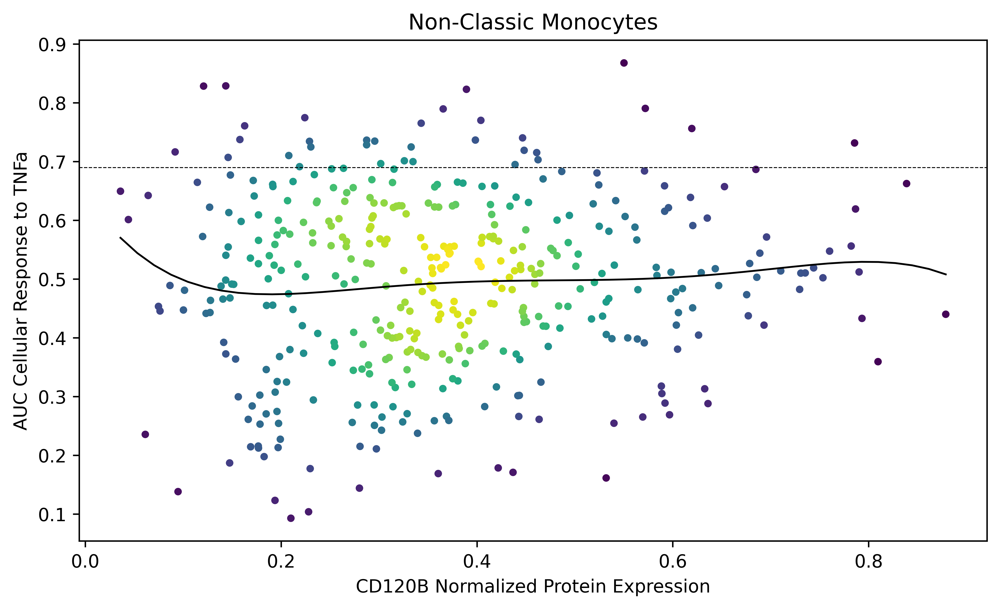

In [96]:
trim = ta_ML_nCm[ta_ML_nCm['CD120B'] <= 1.]
x = trim['CD120B']
y = trim['AUC TNFa']

# Model
CD120B_Mono_model = np.poly1d(np.polyfit(x, y, 5))
line = np.linspace(trim['CD120B'].min(), trim['CD120B'].max())

# Calculate the point density
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
# plot the data
fig, ax = plt.subplots(figsize=(9,5), dpi=600)
ax.scatter(x, y, c=z, s=10)
plt.title('Non-Classic Monocytes')
plt.axhline(y = activation_th, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.plot(line, CD120B_Mono_model(line), color = 'black', linewidth = 1)
# plt.axvline(x = 0.2, color = 'black', linewidth = 0.5)
# Labelling axes
plt.xlabel('CD120B Normalized Protein Expression')
plt.ylabel('AUC Cellular Response to TNFa')

plt.savefig('Non-Classic Monocytes CD120B.png', bbox_inches='tight')

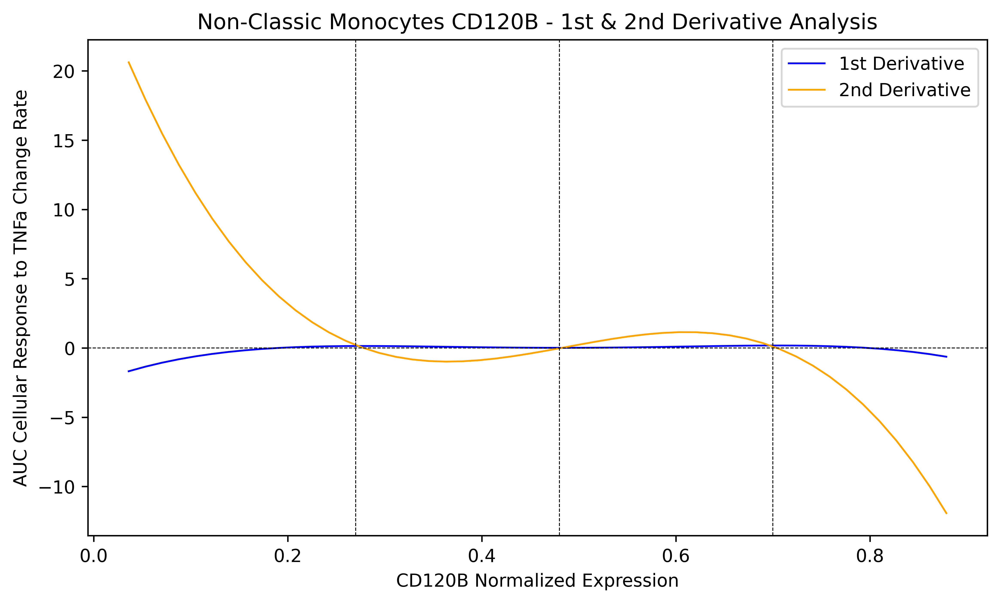

In [103]:
p1 = np.polyder(CD120B_Mono_model, 1)
p2 = np.polyder(CD120B_Mono_model, 2)

plt.figure(figsize=(9,5), dpi=600)
plt.plot(line, p1(line), color = 'blue', linewidth = 1, label="1st Derivative")
plt.plot(line, p2(line), color = 'orange', linewidth = 1, label="2nd Derivative")
plt.axvline(x = 0.27, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axvline(x = 0.48, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axvline(x = 0.7, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axhline(y = 0, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.legend(loc="upper right")

plt.title('Non-Classic Monocytes CD120B - 1st & 2nd Derivative Analysis')
# Labelling axes
plt.xlabel('CD120B Normalized Expression')
plt.ylabel('AUC Cellular Response to TNFa Change Rate')

plt.savefig('Non-Classic Monocytes CD120B DA.png', bbox_inches='tight')

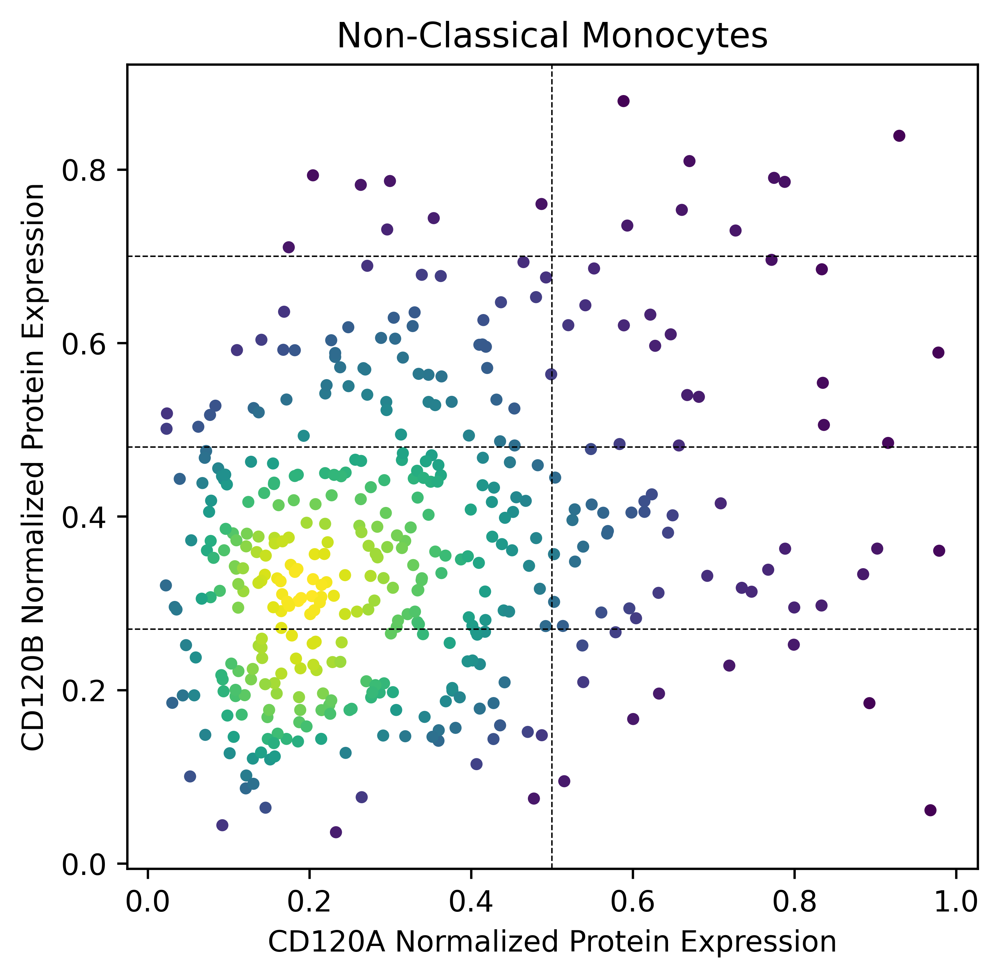

In [131]:
trim = ta_ML_nCm[ta_ML_nCm['CD120A'] <= 1.]
x = trim['CD120A']
y = trim['CD120B']

# Calculate the point density
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
# plot the data
fig, ax = plt.subplots(figsize=(5.25,5), dpi=600)
ax.scatter(x, y, c=z, s=10)
plt.title('Non-Classical Monocytes')

plt.axvline(x = 0.5, color = 'black', linewidth = 0.5, linestyle='dashed')

plt.axhline(y = 0.27, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axhline(y = 0.48, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axhline(y = 0.7, color = 'black', linewidth = 0.5, linestyle='dashed')
# Labelling axes
plt.xlabel('CD120A Normalized Protein Expression')
plt.ylabel('CD120B Normalized Protein Expression')

plt.savefig('Non-Classical Monocytes DA.png', bbox_inches='tight')

### Per-biogroup Analysis

In [104]:
ta_ML_Cm_PBMCs = ta_ML_Cm[ta_ML_Cm['Group_PBMCs'] == 1]
ta_ML_Cm_PBMCs

,AUC TNFa,CD120A,CD120B,Cell Type_B-cells,Cell Type_CD4 Memory T-Cells,Cell Type_CD4 NKT-cells,Cell Type_CD4 Naïve T-Cells,Cell Type_CD8 Memory T-Cells,Cell Type_CD8 NKT-cells,Cell Type_CD8 Naïve T-Cells,...,Sample_PBMCs + TNFa 3,Sample_PBMCs 1,Sample_PBMCs 2,Sample_PBMCs 3,Sample_PBMCs RA + TNFa 1,Sample_PBMCs RA + TNFa 2,Sample_PBMCs RA + TNFa 3,Sample_PBMCs RA 1,Sample_PBMCs RA 2,Sample_PBMCs RA 3
Cell_Index,,,,,,,,,,,,,,,,,,,,,
Group_PBMCs_Sample_PBMCs 1_294188,0.446483,0.426266,0.815381,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_1198653,0.611063,0.602209,0.710694,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_2034439,0.731154,0.245327,0.549734,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_3366978,0.303050,0.735913,0.536127,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 1_3654198,0.395195,0.613691,0.278542,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Group_PBMCs_Sample_PBMCs 3_55985020,0.487808,0.385264,0.300498,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 3_56223372,0.180945,0.141582,0.255991,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
Group_PBMCs_Sample_PBMCs 3_56416614,0.476838,0.325164,0.726504,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0


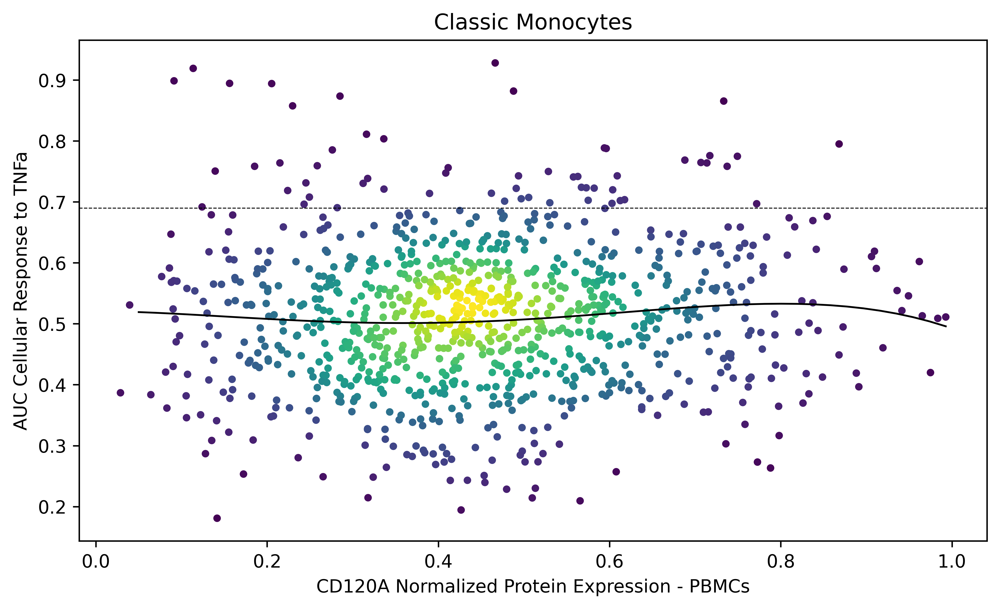

In [106]:
trim = ta_ML_Cm_PBMCs[ta_ML_Cm_PBMCs['CD120A'] <= 1]
x = trim['CD120A']
y = trim['AUC TNFa']

CD120A_Mono_model = np.poly1d(np.polyfit(x, y, 4))
line = np.linspace(0.05, trim['CD120A'].max())

# Calculate the point density
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
# plot the data
fig, ax = plt.subplots(figsize=(9,5), dpi=600)
ax.scatter(x, y, c=z, s=10)
plt.title('Classic Monocytes')
plt.axhline(y = activation_th, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.plot(line, CD120A_Mono_model(line), color = 'black', linewidth = 1)

# Labelling axes
plt.xlabel('CD120A Normalized Protein Expression - PBMCs')
plt.ylabel('AUC Cellular Response to TNFa')

plt.savefig('Classic Monocytes CD120A PBMCs.png', bbox_inches='tight')

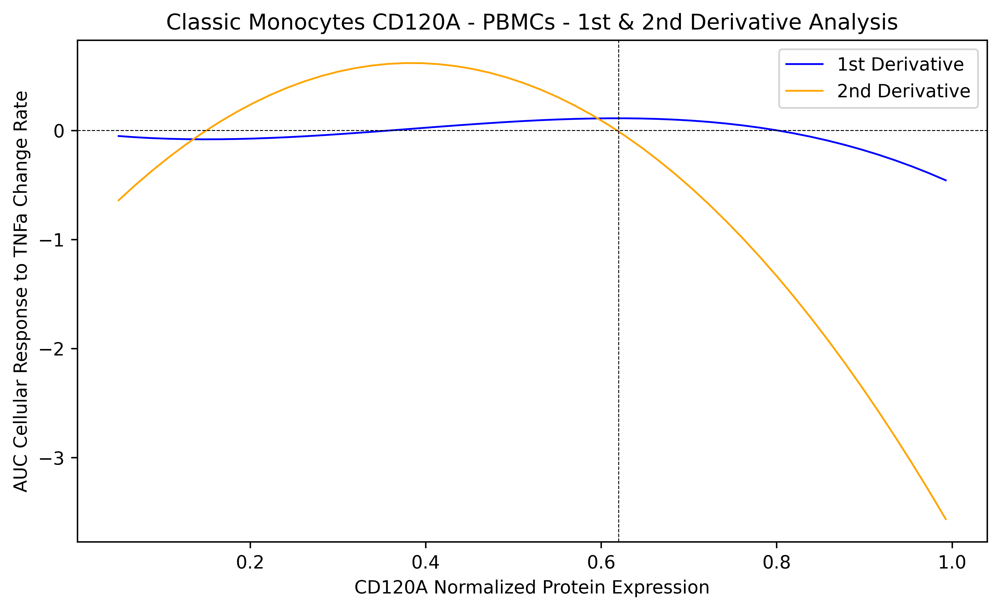

In [108]:
p1 = np.polyder(CD120A_Mono_model, 1)
p2 = np.polyder(CD120A_Mono_model, 2)

plt.figure(figsize=(9,5), dpi=600)
plt.plot(line, p1(line), color = 'blue', linewidth = 1, label="1st Derivative")
plt.plot(line, p2(line), color = 'orange', linewidth = 1, label="2nd Derivative")
plt.axvline(x = 0.62, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axhline(y = 0, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.legend(loc="upper right")

plt.title('Classic Monocytes CD120A - PBMCs - 1st & 2nd Derivative Analysis')
# Labelling axes
plt.xlabel('CD120A Normalized Protein Expression')
plt.ylabel('AUC Cellular Response to TNFa Change Rate')

plt.savefig('Classic Monocytes CD120A PBMCs DA.png', bbox_inches='tight')

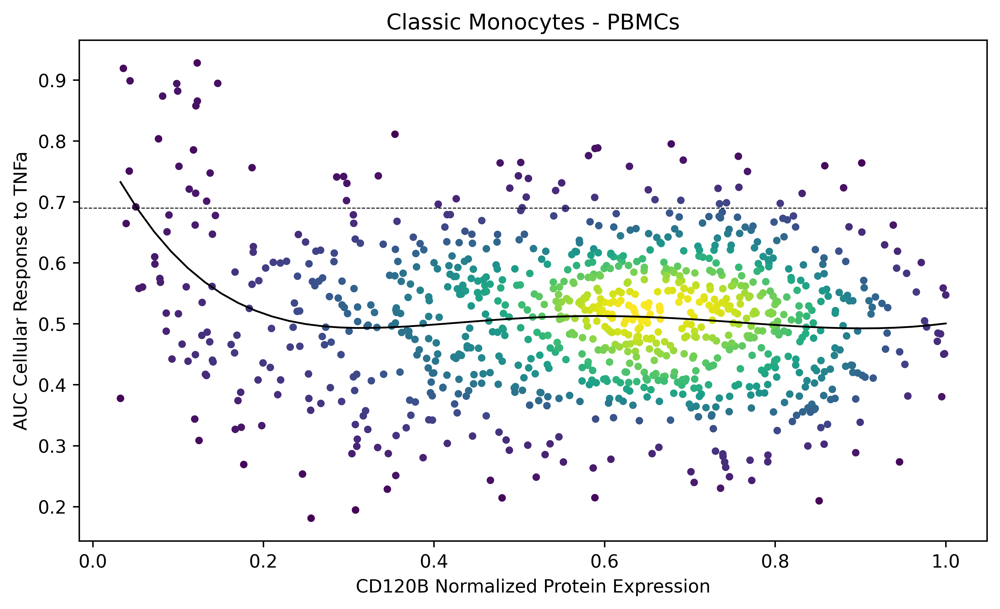

In [110]:
trim = ta_ML_Cm_PBMCs[ta_ML_Cm_PBMCs['CD120B'] <= 1.]
x = trim['CD120B']
y = trim['AUC TNFa']

# Model
CD120B_Mono_model = np.poly1d(np.polyfit(x, y, 5))
line = np.linspace(trim['CD120B'].min(), trim['CD120B'].max())

# Calculate the point density
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
# plot the data
fig, ax = plt.subplots(figsize=(9,5), dpi=600)
ax.scatter(x, y, c=z, s=10)
plt.title('Classic Monocytes - PBMCs')
plt.axhline(y = activation_th, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.plot(line, CD120B_Mono_model(line), color = 'black', linewidth = 1)

# Labelling axes
plt.xlabel('CD120B Normalized Protein Expression')
plt.ylabel('AUC Cellular Response to TNFa')

plt.savefig('Classic Monocytes CD120B PBMCs.png', bbox_inches='tight')

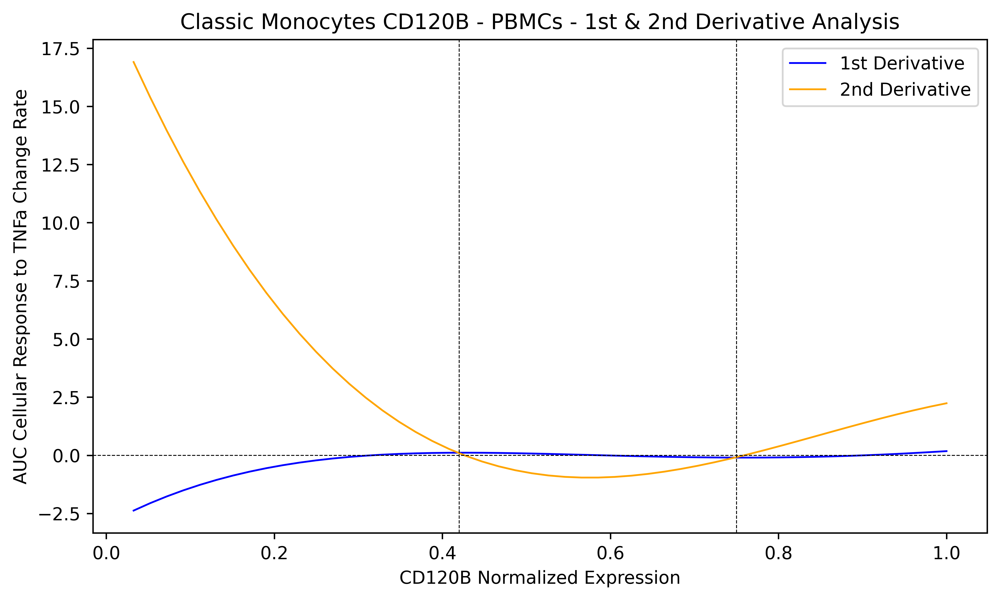

In [113]:
p1 = np.polyder(CD120B_Mono_model, 1)
p2 = np.polyder(CD120B_Mono_model, 2)

plt.figure(figsize=(9,5), dpi=600)
plt.plot(line, p1(line), color = 'blue', linewidth = 1, label="1st Derivative")
plt.plot(line, p2(line), color = 'orange', linewidth = 1, label="2nd Derivative")
plt.axvline(x = 0.42, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axvline(x = 0.75, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.axhline(y = 0, color = 'black', linewidth = 0.5, linestyle='dashed')
plt.legend(loc="upper right")

plt.title('Classic Monocytes CD120B - PBMCs - 1st & 2nd Derivative Analysis')
# Labelling axes
plt.xlabel('CD120B Normalized Expression')
plt.ylabel('AUC Cellular Response to TNFa Change Rate')

plt.savefig('Classic Monocytes CD120B PBMCs DA.png', bbox_inches='tight')